In [1]:
import numpy as np
import pandas as pd
import pathlib
import seaborn as sns
import matplotlib.pyplot as plt
from datetime import datetime
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from matplotlib.lines import Line2D
import matplotlib as mpl
from itertools import cycle

debug = True

In [2]:
def read_csvs():
    """
    Reads all csv files in folder path given and stores them in a single dataframe df 
    Parameters: None
    ----------
    Returns
    -------
    pandas.DataFrame
        Dataframe where rows are individual data and columns for indicative
        information on the data like datetime, month, week, country etc
    """

    df = pd.DataFrame()
    dateparse = lambda x: datetime.strptime(x, '%Y-%m-%d %H:%M:%S')

    # For every csv file in folder 
    for csv in pathlib.Path('../Temp Load Data/').glob('*.csv'):
        print("Loading dataset: "+csv.stem)
        temp_df = pd.read_csv(csv,
                              parse_dates=['Date'],
                              dayfirst=True,
                              date_parser=dateparse)
        temp_df['country'] = csv.stem #set cokumn with the name of the dataset this datum came from
        df = pd.concat([df,temp_df]) 
    print('Data loading complete!')
    # sort values based on Start column (Datetime)
    df = df[df['year'] != 2022] # remove rows of year 2022 since its an incomplete year (not currently ended)
    df.sort_values(by=['Date'], ascending=True, inplace=True)
    return df

df = read_csvs()

Loading dataset: Austria
Loading dataset: Belgium
Loading dataset: Bulgaria
Loading dataset: Croatia
Loading dataset: Czechia
Loading dataset: Denmark
Loading dataset: Estonia
Loading dataset: Finland
Loading dataset: France
Loading dataset: Germany
Loading dataset: Greece
Loading dataset: Hungary
Loading dataset: Ireland
Loading dataset: Italy
Loading dataset: Latvia
Loading dataset: Lithuania
Loading dataset: Netherlands
Loading dataset: Norway
Loading dataset: Poland
Loading dataset: Portugal
Loading dataset: Romania
Loading dataset: Serbia
Loading dataset: Slovakia
Loading dataset: Slovenia
Loading dataset: Spain
Loading dataset: Sweden
Loading dataset: Switzerland
Loading dataset: Ukraine
Data loading complete!


In [3]:
df

,Date,Load,datetime,year,month,yearweek,day,hour,minute,second,weekday,monthday,weekend,yearday,timestamp,holiday,WN,country
0,2015-04-09 23:00:00,6401.0,2015-04-09 23:00:00,2015,4,14,9,23,0,0,3,8,False,98,1428620400,False,3.958333,Austria
0,2015-04-09 23:00:00,27602.0,2015-04-09 23:00:00,2015,4,14,9,23,0,0,3,8,False,98,1428620400,False,3.958333,Spain
0,2015-04-09 23:00:00,1296.0,2015-04-09 23:00:00,2015,4,14,9,23,0,0,3,8,False,98,1428620400,False,3.958333,Slovenia
0,2015-04-09 23:00:00,3081.0,2015-04-09 23:00:00,2015,4,14,9,23,0,0,3,8,False,98,1428620400,False,3.958333,Slovakia
0,2015-04-09 23:00:00,6513.0,2015-04-09 23:00:00,2015,4,14,9,23,0,0,3,8,False,98,1428620400,False,3.958333,Romania
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
58992,2021-12-31 23:00:00,2905.0,2021-12-31 23:00:00,2021,12,51,31,23,0,0,4,30,False,364,1640991600,False,4.958333,Slovakia
36864,2021-12-31 23:00:00,2023.0,2021-12-31 23:00:00,2021,12,51,31,23,0,0,4,30,False,364,1640991600,False,4.958333,Croatia
58992,2021-12-31 23:00:00,1271.0,2021-12-31 23:00:00,2021,12,51,31,23,0,0,4,30,False,364,1640991600,False,4.958333,Slovenia
45288,2021-12-31 23:00:00,4147.0,2021-12-31 23:00:00,2021,12,51,31,23,0,0,4,30,False,364,1640991600,False,4.958333,Bulgaria


In [4]:
#  debug cell: check if all countries have been added
print(len(df['country'].unique()))
print(df['country'].unique())

# list(df.columns):
print("NaN values in dataframe: "+str(df.isnull().sum().sum()))

df.tail()

28
['Austria' 'Spain' 'Slovenia' 'Slovakia' 'Romania' 'Portugal' 'Norway'
 'Netherlands' 'Lithuania' 'Sweden' 'Latvia' 'Ireland' 'Hungary' 'Greece'
 'France' 'Finland' 'Estonia' 'Denmark' 'Czechia' 'Italy' 'Switzerland'
 'Belgium' 'Poland' 'Bulgaria' 'Serbia' 'Croatia' 'Germany' 'Ukraine']
NaN values in dataframe: 0


,Date,Load,datetime,year,month,yearweek,day,hour,minute,second,weekday,monthday,weekend,yearday,timestamp,holiday,WN,country
58992,2021-12-31 23:00:00,2905.0,2021-12-31 23:00:00,2021,12,51,31,23,0,0,4,30,False,364,1640991600,False,4.958333,Slovakia
36864,2021-12-31 23:00:00,2023.0,2021-12-31 23:00:00,2021,12,51,31,23,0,0,4,30,False,364,1640991600,False,4.958333,Croatia
58992,2021-12-31 23:00:00,1271.0,2021-12-31 23:00:00,2021,12,51,31,23,0,0,4,30,False,364,1640991600,False,4.958333,Slovenia
45288,2021-12-31 23:00:00,4147.0,2021-12-31 23:00:00,2021,12,51,31,23,0,0,4,30,False,364,1640991600,False,4.958333,Bulgaria
10609,2021-12-31 23:00:00,18273.0,2021-12-31 23:00:00,2021,12,51,31,23,0,0,4,30,False,364,1640991600,False,4.958333,Ukraine


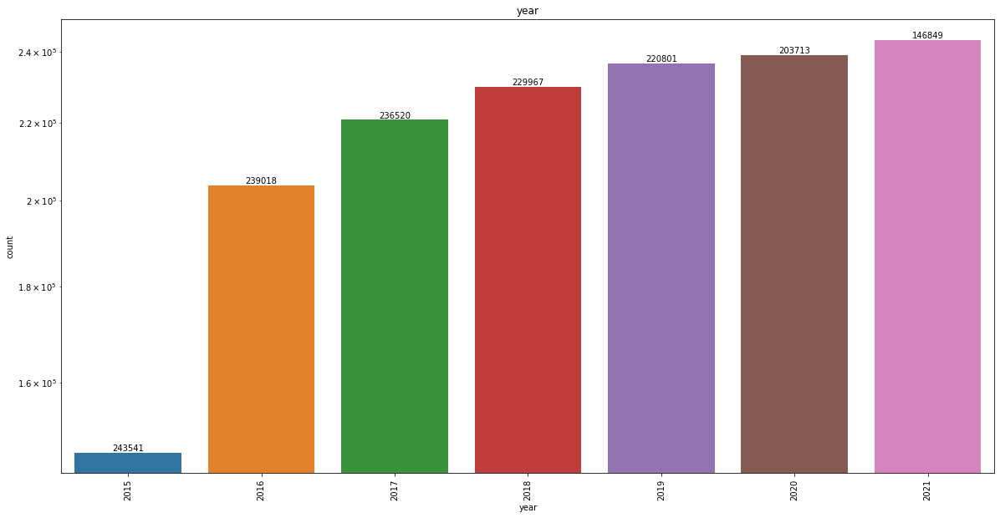

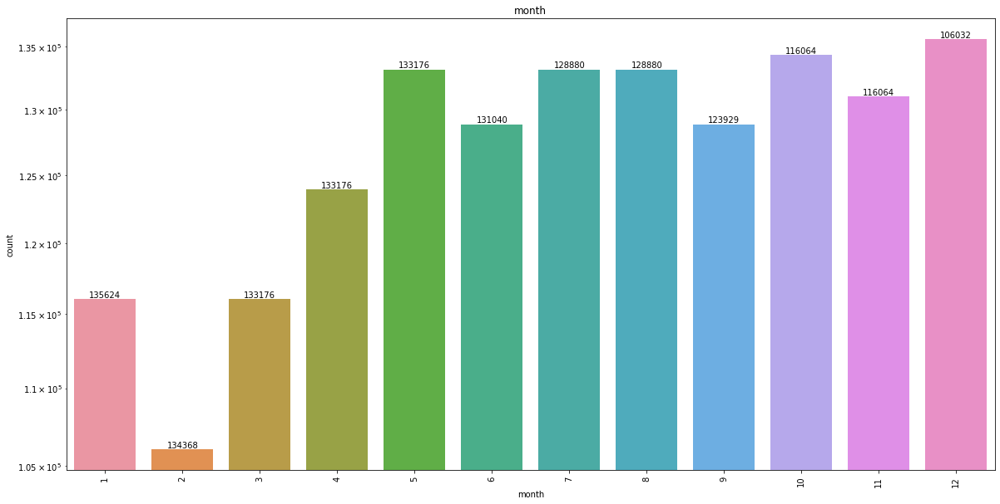

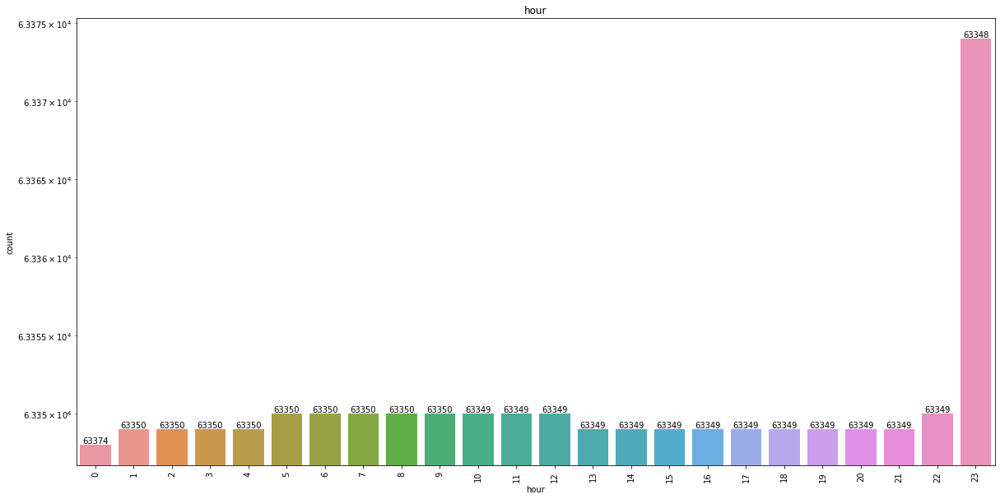

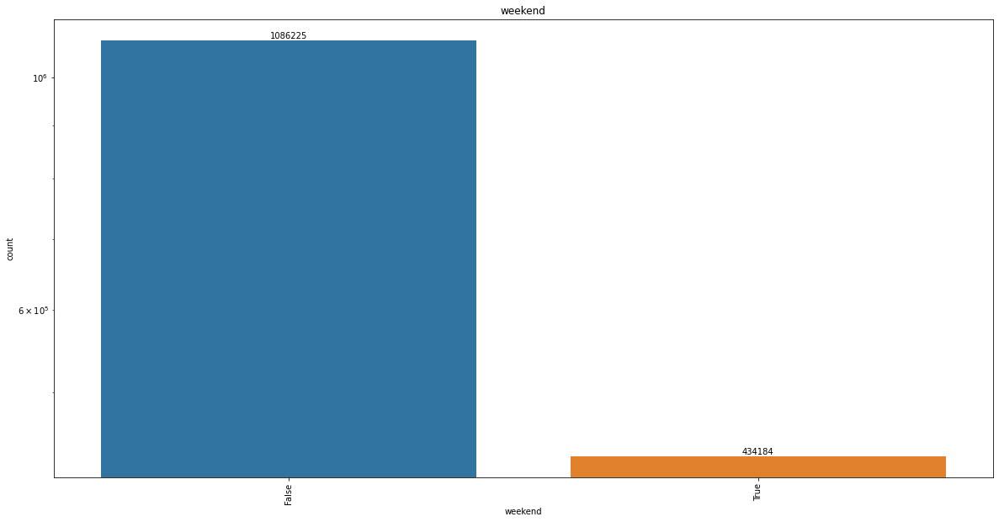

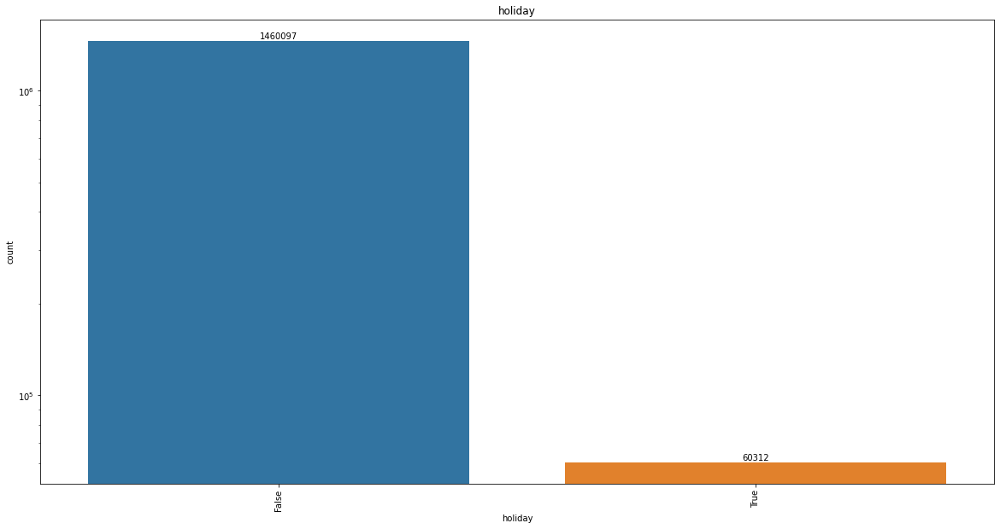

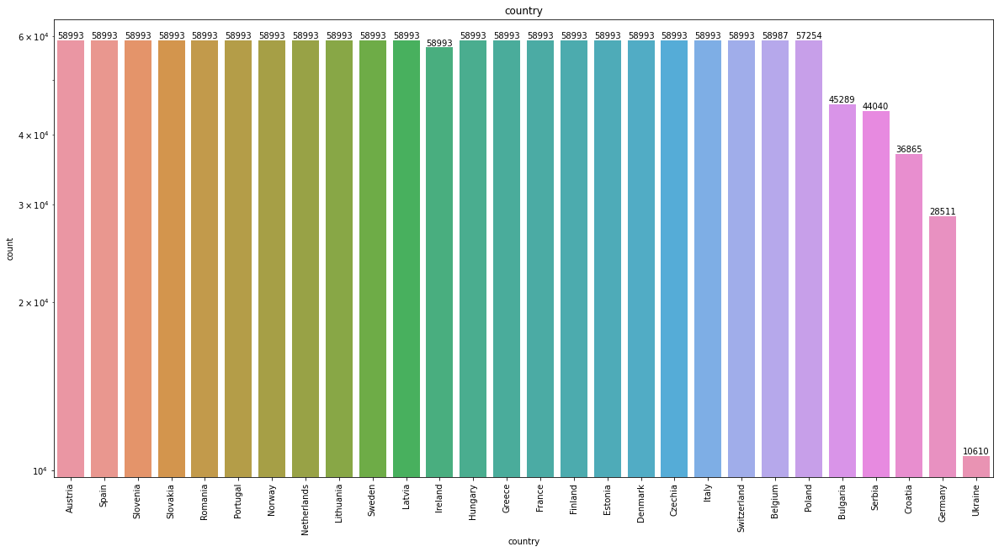

In [5]:
# create a count plot for the columns in for loop
# Countplot: histogram across a categorical (limited possible values), instead of quantitative, variable

def create_barplots():
    for col in ['year', 'month', 'hour','weekend', 'holiday','country']:
        """
        This function creates a countplot for each of datetime_parameters we want in the x-axis
        Parameters: None
        ----------
        Returns: None
        -------
        """
        fig, ax = plt.subplots()
        fig.set_size_inches(20, 10)
        ax = sns.countplot(x=df[col])
        ax.set_yscale('log')
        abs_values = df[col].value_counts(ascending=False).values

        ax.bar_label(ax.containers[0], labels=abs_values,rotation=0)
        plt.title(col)
        plt.xticks(x=abs_values, rotation=90)
        plt.show()

create_barplots()

By creating a few countplots of our data, we make the following deductions:

- Some datasets do not have data for year 2015 and 2022, while most of them do for the years in between
- Months are not homogenously (weird)
- Most datasets have relatively the same amount of data from 7:00 am to 22:00 pm
- Most dates are business days
- Most datasets have the same amount of data exluding a few outliers

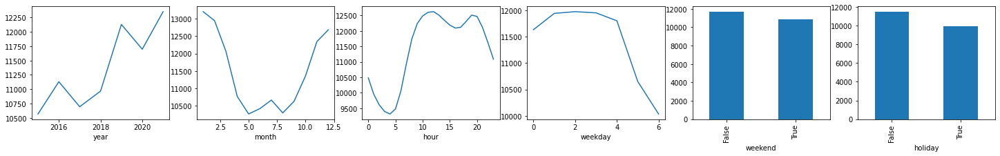

In [6]:
def load_meanplot():
    """
    This function is used to plot the mean energy load per "datatime aspect" (year/month/hour etc)
    Parameters: 
            Dataframe for plotting
    ----------
    Returns: None
    -------
    """
    fig, axes = plt.subplots(1, 6)
    df.groupby('year')['Load'].mean().plot(ax=axes[0], figsize=(25, 3))
    df.groupby('month')['Load'].mean().plot(ax=axes[1], figsize=(25, 3))
    df.groupby('hour')['Load'].mean().plot(ax=axes[2], figsize=(25, 4))
    df.groupby('weekday')['Load'].mean().plot(ax=axes[3], figsize=(25, 3))
    df.groupby('weekend')['Load'].mean().plot.bar(ax=axes[4], figsize=(25, 3))
    df.groupby('holiday')['Load'].mean().plot.bar(ax=axes[5], figsize=(25, 3))

load_meanplot()

We group load based based on a specific variable (x-axis) and plot the mean value

From those graphs we can deduce:
- A upward trend (as year increases, load increases)
- An increase in load demand from September till December and a steady dicrease from January till May (winter months)
- An increase in load demand on business hours (with a slight drop at noon) and proper drop as night approaches
- Load is greater at business days (with significant difference between weekends and not that variant of holidays)

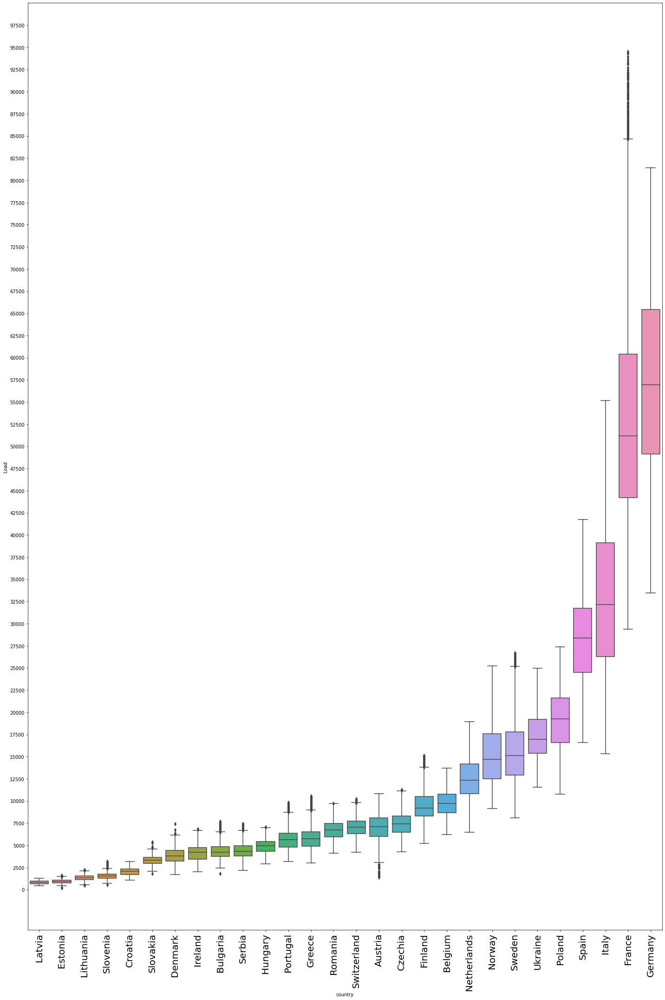

In [7]:
def create_boxplots(neighbouring_countries=None,colour_list=None):
    """
    1.  Reads the initial dataframe df and copies 'load' and 'country' collumns (df_scaled)
    2.  Using df.describe() we get info about the load collumn grouped by countries (neighbouring_countries)
    3.  We sort that collumn based on mean value (given by desrcibe) and 
        make a list of the countries sorted by the mean of load collumn
    4.  then we sort our initial dataset based on the list in step 3 (neighbour_df)
    5.  Finally, we make side by side box plots of the distribution of load for each country 
        in our dataset
    Parameters: 
        neighbouring_countries: (optional) simple list of countries to plot side by side barplots
        colour_list: (optional) simple list of colours to colour neighbouring countries
        
    Returns: None
    -------
    """
    df_scaled = df[['country', 'Load']].copy()
    
    if(neighbouring_countries is None):
        #group data by country and describe load data column
        neighbouring_countries = df_scaled.groupby('country')['Load'].describe()

        # sort above description by mean value and create the list of countries produced by that sorting
        neighbouring_countries = neighbouring_countries.sort_values(by=['mean']).index.get_level_values(0).to_list()

    # use the country column as index and sort dataset by the list of countries sorted by mean
    neighbour_df = df_scaled.set_index('country').loc[neighbouring_countries]

    neighbour_df.reset_index(inplace=True)
    fig, ax = plt.subplots()
    fig.set_size_inches(20, 30)
    if(colour_list is None):
        ax = sns.boxplot(x='country', y='Load', data=neighbour_df)
    else:
        ax = sns.boxplot(x='country', y='Load', data=neighbour_df,palette=colour_list)
        
    plt.xticks(fontsize=20, rotation=90)
    plt.yticks(range(0,100000,2500))
    plt.ylim(top=100000) 
    plt.tight_layout()
    
create_boxplots()

We can conclude that the amount of energy demand is determined by a country's:
- Population
- maintenance and productivity

From that box plot we can see visually which datasets have similar values and their variance, which will be used to determine which ones are going to be grouped together (source) to forecast values of a target with similar values
Also, we can easily group countries with similar distribution of energy demand
By sorting them in increasing order:
- Latvia - Estonia
- Lithuania - Slovenia
- Denmark - Croatia
- Ireland - Bulgaria - Serbia (- Hungary)
- Portugal - Greece
- Romania - Switcherland - Austria - Czech Republic
- Finland - Belgium
- (France - Germany)?

In [8]:
def create_pivot_df():
    """
    Reads the initial dataframe df and creates a pivot_table out of it
    Each row of the pivot table containts the mean (by default) value of 
    energy load at a specific datetime for all countries
    Each row is a different datetime, while each column is a different country
    Countries are sorted based on ascending mean value of energy load
    Parameters: None        
    Returns
    -------
    pandas.DataFrame
        The pivot table of the oriiginal dataframe as described above
    """
    # get description table (describe()) and group based on country for only "load" column
    neighbouring_countries = df.groupby('country')['Load'].describe()

    # sort above description by mean value and create the list of countries produced by that sorting
    neighbouring_countries = neighbouring_countries.sort_values(by=['mean']).index.get_level_values(0).to_list()
    pivot_df = df.pivot_table('Load', ['Date'], 'country')

    # sort columns based on ascending order of mean value per country (see boxplots above)
    pivot_df = pivot_df.reindex(columns=neighbouring_countries)
    print('NaN left in pivot table?: '+str(pivot_df.isnull().values.any()))
    return pivot_df

pivot_df = create_pivot_df()

NaN left in pivot table?: True


In [9]:
if(debug):
    print(pivot_df.head())

country              Latvia  Estonia  Lithuania  Slovenia  Croatia  Slovakia  \
Date                                                                           
2015-04-09 23:00:00   661.0    787.0      967.0    1296.0      NaN    3081.0   
2015-04-10 00:00:00   622.0    754.0      930.0    1190.0      NaN    2964.0   
2015-04-10 01:00:00   600.0    735.0      907.0    1166.0      NaN    2856.0   
2015-04-10 02:00:00   596.0    729.0      899.0    1150.0      NaN    2798.0   
2015-04-10 03:00:00   606.0    733.0      903.0    1143.0      NaN    2811.0   

country              Denmark  Ireland  Bulgaria  Serbia  ...  Belgium  \
Date                                                     ...            
2015-04-09 23:00:00   3225.0   4325.0       NaN     NaN  ...  10797.0   
2015-04-10 00:00:00   2977.0   3778.0       NaN     NaN  ...  10141.0   
2015-04-10 01:00:00   2861.0   3376.0       NaN     NaN  ...   9462.0   
2015-04-10 02:00:00   2827.0   3165.0       NaN     NaN  ...   8995.0   
2

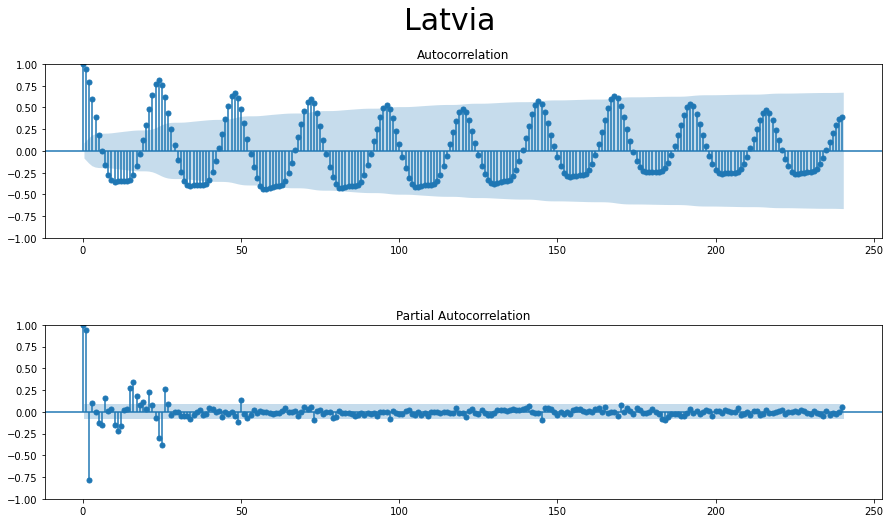

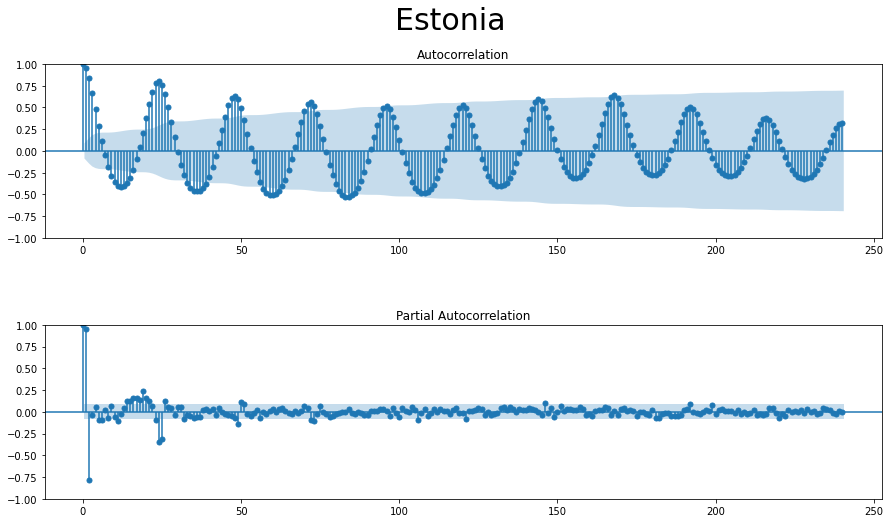

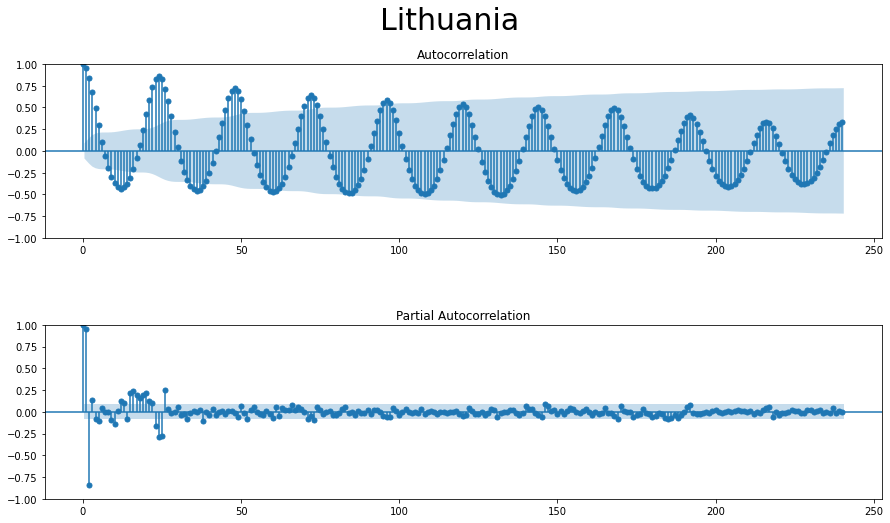

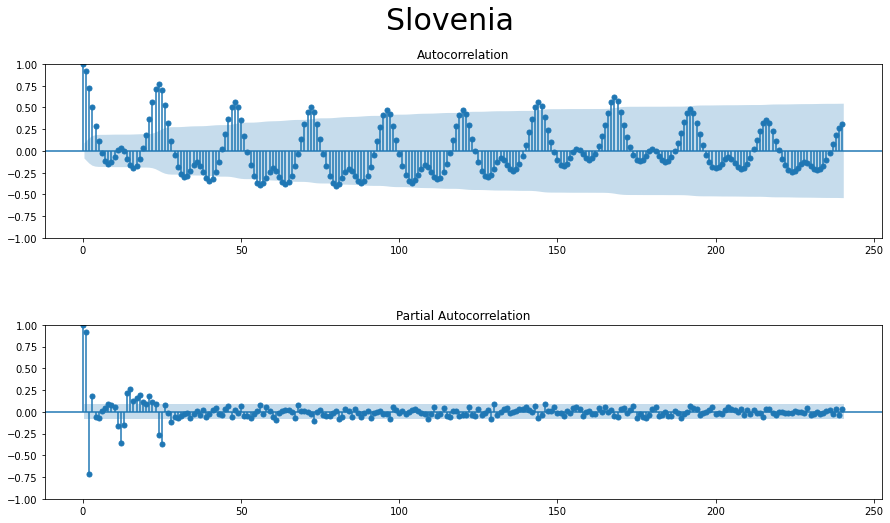

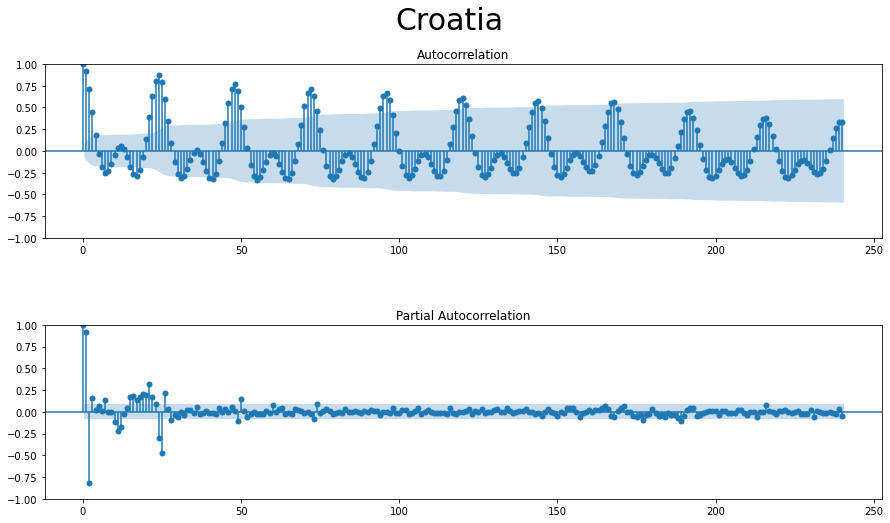

...

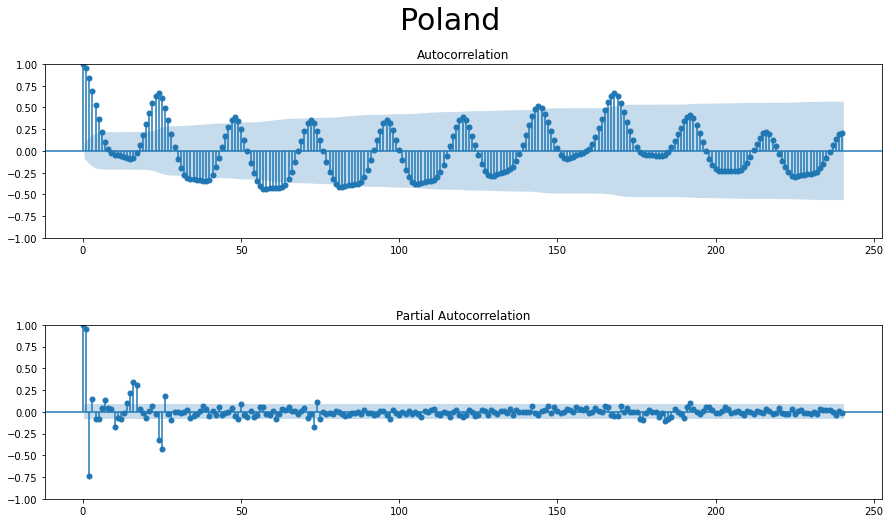

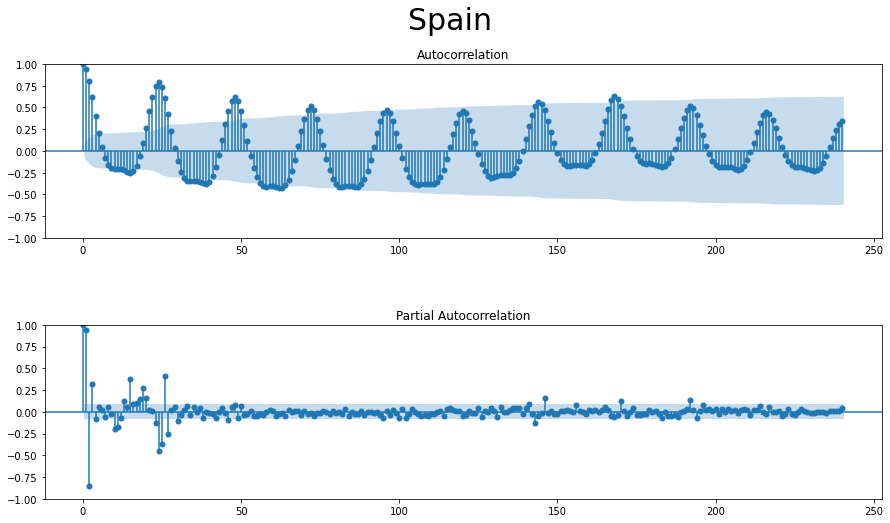

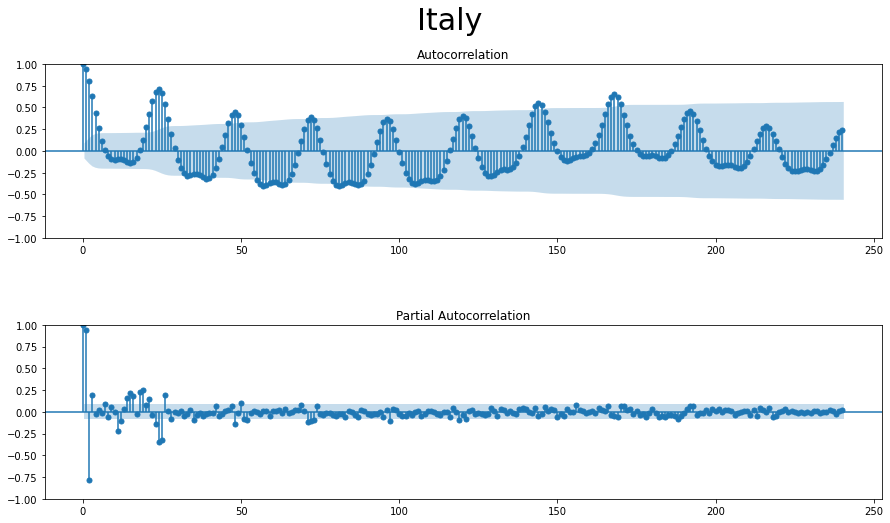

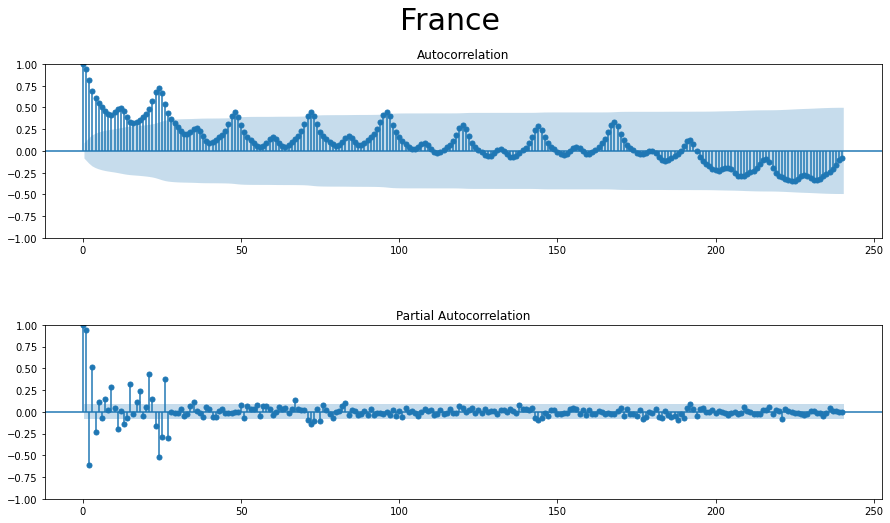

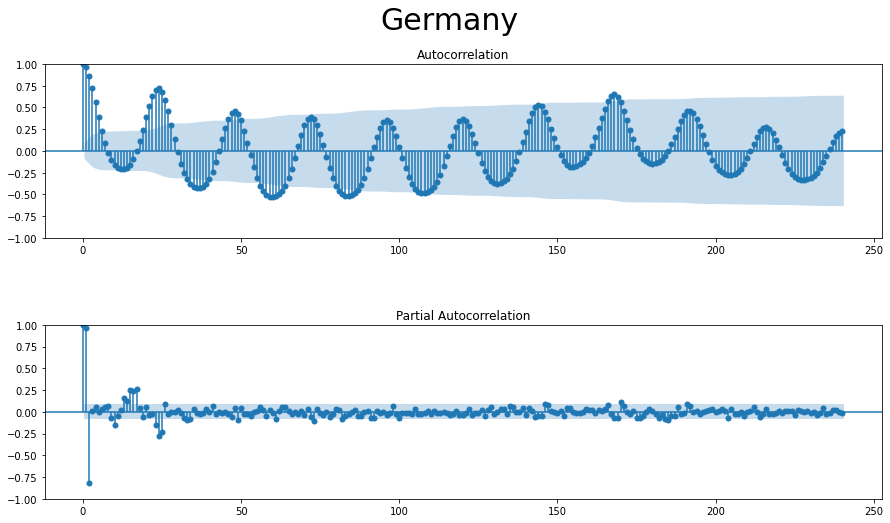

In [10]:
import statsmodels.api as sm

def plot_acf_pacf(dframe):
    """
    This function is used to plot acf/pacf plots for each country in our dataset
    Parameters: 
        dframe: pandas.dataframe (pivot table) where rows are data per country for one datetime        
    Returns: None
    -------
    """    
    # we need to remove NaN values since they can't be used for acf/pacf plots
    dframe_without_na = dframe.dropna()
    sample_size = 500 
    
    for country in dframe.columns:
        fig, ax = plt.subplots(2,1, figsize=(15, 8))
        fig.suptitle(country, fontsize=30)
        fig.subplots_adjust(hspace=0.5)
        
        """
        get a random value (idx) between 0 and lenth of current col 
        We subtract 'sample_size' so that rand_idx might not become a number that
        added with 'sample_size' can become more than length of current col 
        """
        rand_idx = np.random.randint(0,len(dframe_without_na[country].values)-sample_size)

        # get a contrinuous 'sample_size' values (sample) of dframe starting from said random idx
        dframe_sample = dframe_without_na.iloc[rand_idx : rand_idx+sample_size]
        
        # plot acf/pacf plots
        sm.graphics.tsa.plot_acf(dframe_sample[country], lags=24*10, ax=ax[0])    
        sm.graphics.tsa.plot_pacf(dframe_sample[country], lags=24*10, ax=ax[1],method='ywm')
        plt.show()
        
plot_acf_pacf(pivot_df)



ACF plots determine the correlation between data at current time and with the past (1-unit past, 2-unit past, …, n-unit past) values. We use them to determine seasonality, trend, cyclic and residual which are all taken into consideration
PACF plots display is the amount of correlation between a variable and a lag of itself that is not explained by correlations at all lower-order-lags.They are mostly used to determine how the individual lags affect present time without any lags in between and makes it clearer as to what model can best estimate the time series

__Autoregressive(AR) Model__: For a MA model,we will certainly observe its ACF plot to have a tapering or sinusoidal pattern that converges to 0, possibly alternating negative and positive signs. As for its PACF plot, it's going to display significant values at the first p lags, then non-significant value	
__Moving Average(MA) Model__: For a MA model,we will certainly observe its ACF plot to have significant values at the first q lags, then non-significant values. As for its PACF plot, it's going to display tapering or sinusoidal pattern that converges to 0, possibly alternating negative and positive signs
__Both AR and MA terms (ARMA)__: Both ACF and PACF plot are going to display a tapering or sinusoidal pattern that converges to 0, possibly alternating negative and positive signs	

As it is evident of our plots, our data appear can be modeled a pure AR model. We can, also, easily observe the high __seasonality__ pattern of our dataset, since the lags oscilate sinusoidally appoximately every 24 lags (as in 24 hours of the day). 
An additional observation is that for several (almost exclusively at) Eastern Europe countries (Slovenia,Slovakia,Romania etc) there appears to be a double slope at each oscilation in the ACF plot

In [20]:
import random
import string

def country_histograms(dframe,colourmap='tab20',country_list=None):
    """
    In this function, we create overlapping histograms where each histogram is 
    for a different country 
    Parameters: 
        dframe: pandas.dataframe for plotting histogram
        colourmap: string representing matplotlib set of colours for histogram
        country_list: (optional) list of countries to explicitely add to histogram
    ----------
    Returns: None
    -------
    """
    custom_lines = []
    countries = []
    pallete = []

    fig, ax = plt.subplots(figsize=(20,15))
    
    if country_list is not None:  # if used by other function
        # get columns that contain any country from the list 'weak_corr_countries'
        temp = dframe.drop(columns=[col for col in pivot_df 
                                      if col not in country_list])
    else: #if used independently
        # see code from previous cell for relative explanation of code
        temp = dframe
    
    ax.set(xlabel='Energy load', ylabel='Count')
    ax.set_title('Overlapping Histograms for each country',fontsize = 40)
    custom_fontsize = 10

    # ~~~~~~~~~~~~~~~~~~~~~ Colour based on cmap ~~~~~~~~~~~~~~~~~~~~~~~~~~
    # https://matplotlib.org/stable/tutorials/colors/colormaps.html    
    cmap_samples = mpl.cm.get_cmap(colourmap) 
    """
    colours change every 1/#colours (1/20 = 0.05), so for each value where there
    is new colour we add that colour, using cmap(), in a list and cycle through
    that list for every histogram we plot
    """
    for val in np.arange(0, 1, 0.05).tolist(): pallete.append(cmap_samples(val))
    pallete_cycler = cycle(pallete)
    
    for idx, col in enumerate(temp.columns):
        # ~~~~~~~~~~~~~~~~~~~ Randrom colour per hist ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
#         cur_colour = "#" + ''.join(random.choices("ABCDEF" + string.digits, k=6))

        # ~~~~~~~~~~ Colour based on max correlation of country ~~~~~~~~~~~~~~~~~
#         sorted_corr = dframe.corr().unstack().sort_values().drop_duplicates()
#         max_corr = sorted_corr[col][:].max()
#         cur_colour = cmap(max_corr)

        # ~~~~~~~~~~ Colour based on a mlp cmap ~~~~~~~~~~~~~~~~~
        cur_colour = next(pallete_cycler)

        sns.histplot(temp[col], ax=ax, kde=True, color=cur_colour)
        custom_lines.append(Line2D([0], [0], color=cur_colour, lw=4))
        countries.append(col)

    ax.legend(custom_lines, countries, fontsize=10)
    plt.xticks(fontsize=10)
    plt.yticks(fontsize=10)

In [19]:
def corr_heatmap(dframe,cluster_labels=None):
    """
    Creates correlation map of dframe between different countries 
    Parameters: 
        dframe: pandas.dataframe of our dataset
        cluster_labels: (optionally) list of labels from hierarchical clustering (see create_dendrogram() below)
    ----------
    Returns: None
    -------
    """
    # Compute the correlation matrix (excluding NA/null values)
    corr = dframe.corr()
    
    cmap = 'Spectral_r'
    # Generate a mask for the upper triangle
    mask = np.triu(np.ones_like(corr, dtype=bool))

    # Set up the matplotlib figure
    f, ax = plt.subplots(figsize=(20, 15))

    # Draw the heatmap with the mask and correct aspect ratio
    res = sns.heatmap(corr, mask=mask, cmap=cmap, square=True, annot=True, 
                      annot_kws={"size": 10}, ax=ax)

    # size of country names
    res.set_xticklabels(res.get_xmajorticklabels(), fontsize = 10, rotation = 90)
    res.set_yticklabels(res.get_ymajorticklabels(), fontsize = 10, rotation = 0); # ";" to supress print in cell

    # change font size of heatmap colourbar
    cbar = ax.collections[0].colorbar
    cbar.ax.tick_params(labelsize=20)
    ax.set_title('Country Correlation Heatmap',fontsize = 40)

    weak_corr_countries = ['Switcherland','Finland','Belgium','Greece',
                           'Netherlands','Sweden','Norway','Portugal','Hungary',
                           'Ireland','Spain']
    
    # create histogram for countries 
    if cluster_labels is not None:
        for cluster, countries in cluster_labels.items():
            country_histograms(dframe,cmap,countries)
    else:
        country_histograms(dframe,cmap,weak_corr_countries)

From the heatmap, there is a clearly strong correlation between most countries meaning that with an increase/dicrease in a country's energy load there is a relative increase/dicrease in most country's load. 
A weak(er) correlation is present between scandinavian countries (with clear example their correlation with greece) which can be attributed to:
- Geographical location (more cold, greater distances)
- Strong agricultrue or natural oil/gases
- Better energy utilisation and energy-saving consciousness
- Generally bigger energy demand (as displayed by overlapping histograms)

In [101]:
import plotly.express as px
import plotly.graph_objects as go

def create_choropleth(eu_countries=None,colour_list=None):
    """
     This function is used by dendrogram to create a choropleth europe map based on grouping of dendrogram
     Parameters: 
        eu_countries: list of countries grouped by dendrogram 
        colour_list: list of colours used by dendrofram
    ----------
    Returns: None
    -------
    """ 
    geo_df = pd.DataFrame()
    
    geo_df['country'] = eu_countries
    geo_df['colour'] = colour_list

    fig = px.choropleth(geo_df, locations='country',
                        color='colour', 
                        hover_name='country', 
                        hover_data=['country'], 
                        title='Country Grouping',
                        locationmode= 'country names',
                        projection='natural earth',
                        scope ='europe')
    fig.show()
    

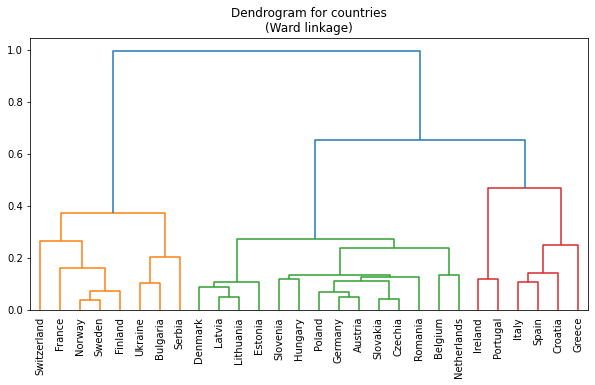

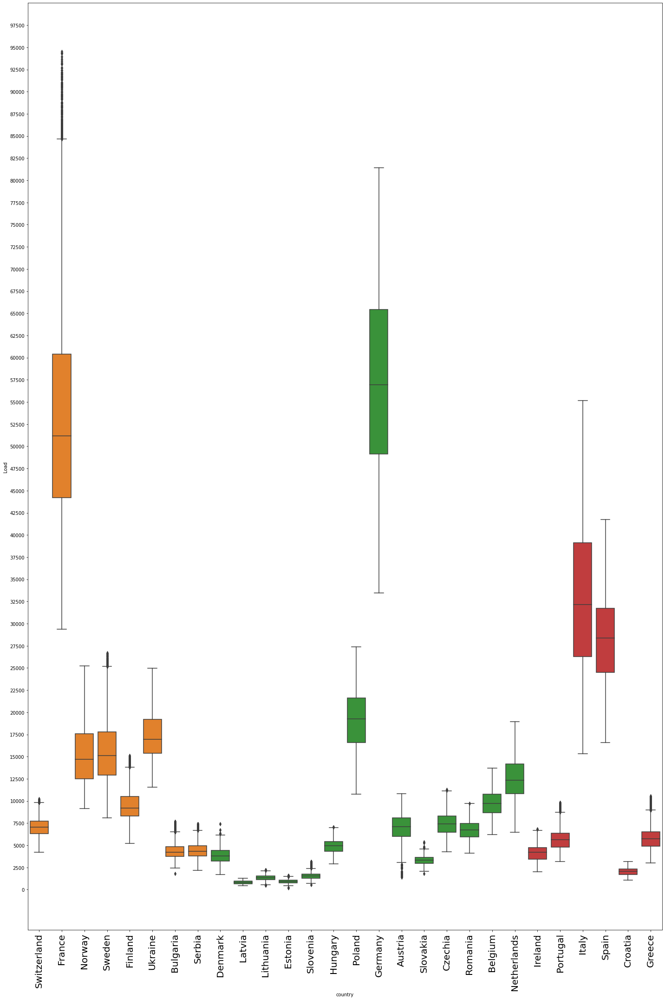

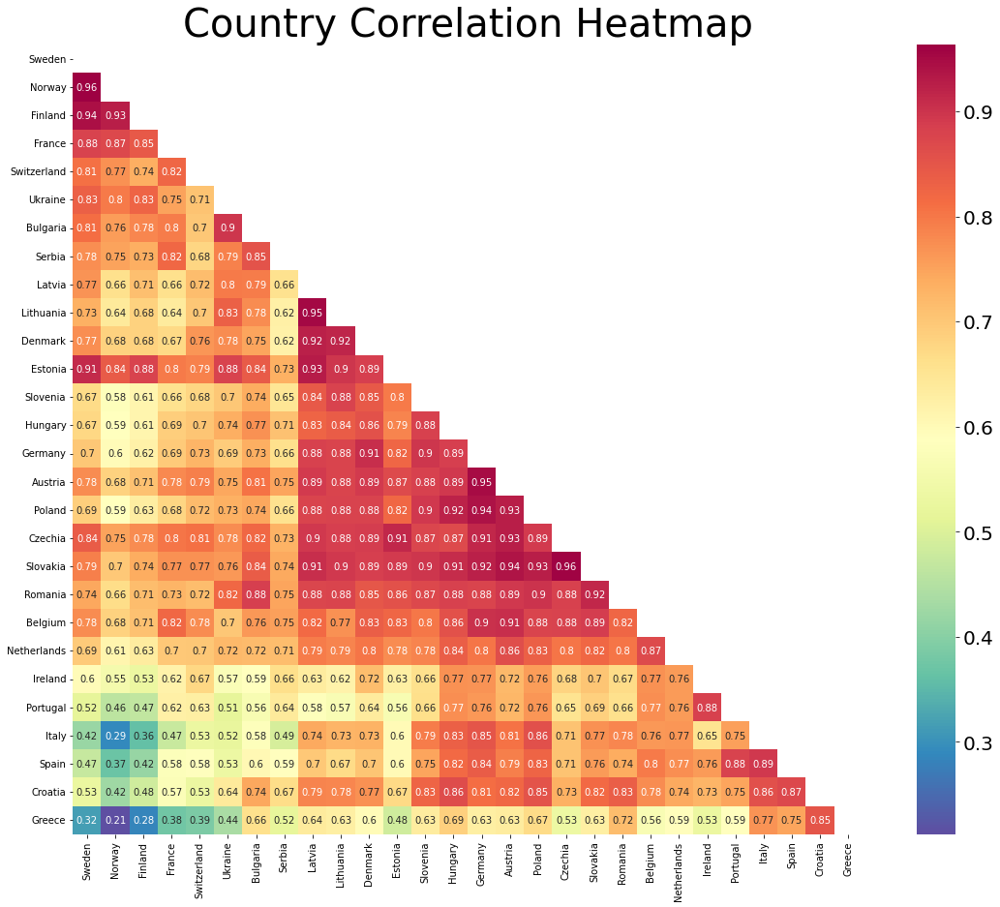

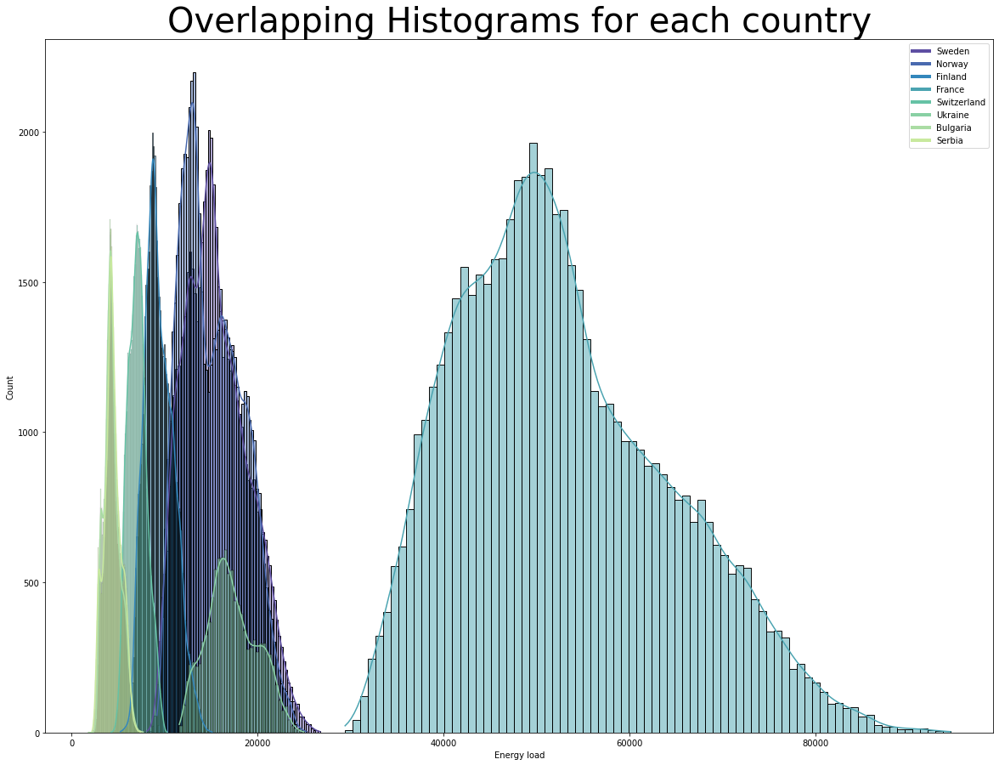

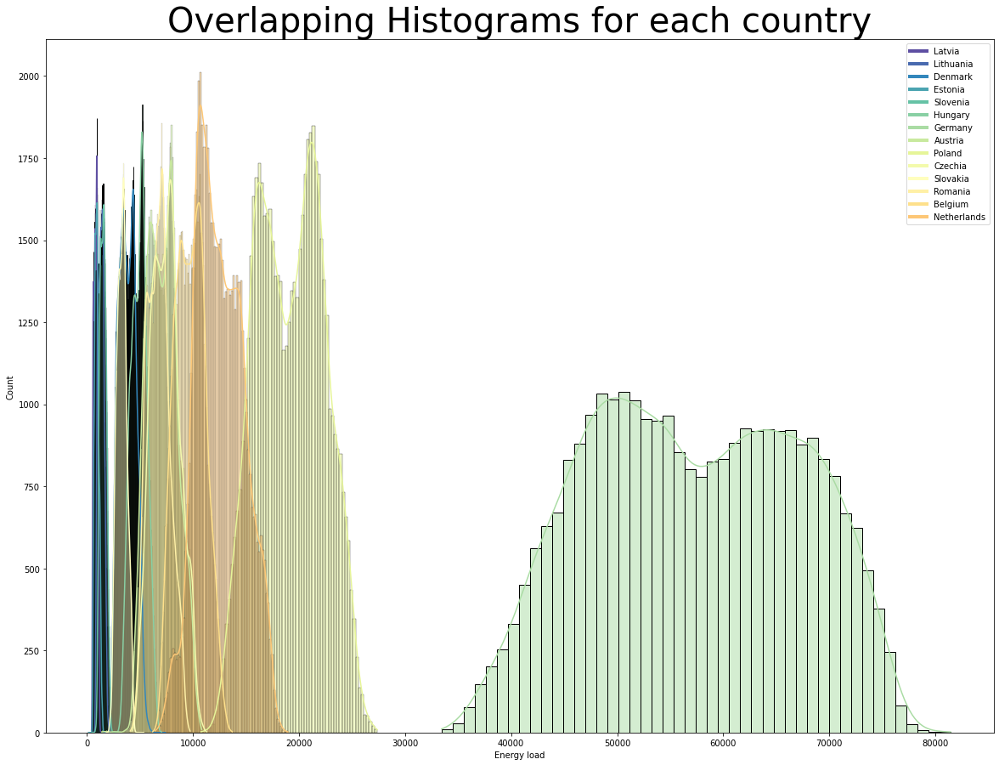

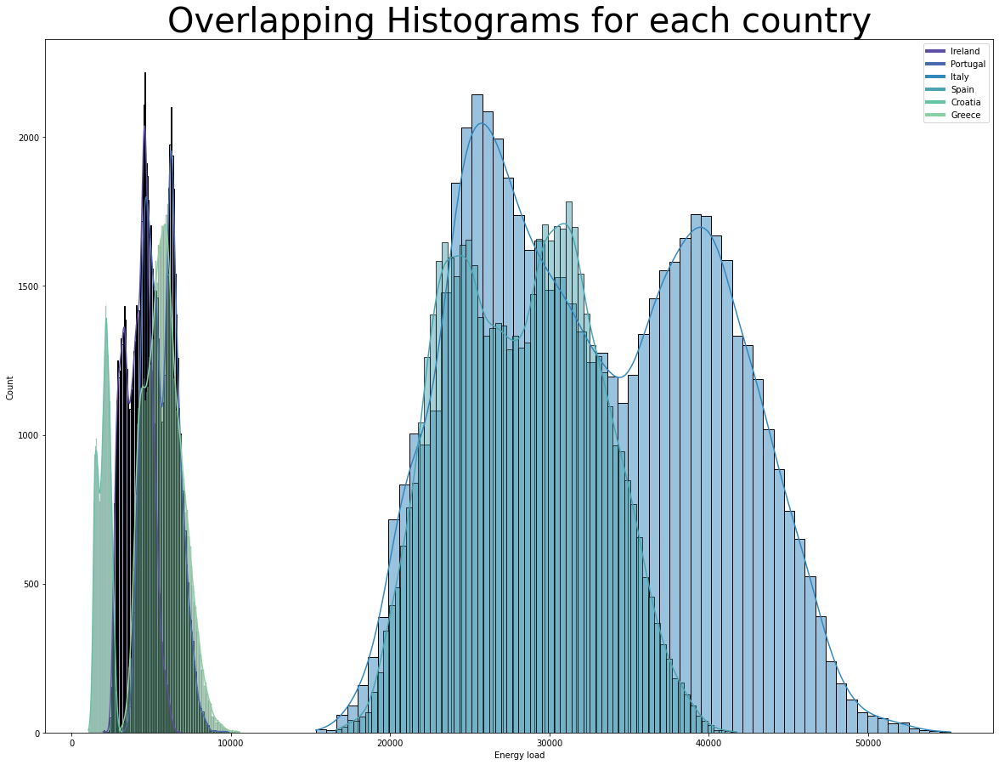

In [102]:
# https://www.kaggle.com/code/sgalella/correlation-heatmaps-with-hierarchical-clustering
from scipy.cluster.hierarchy import linkage, dendrogram, fcluster
from scipy.spatial.distance import squareform
from collections import defaultdict

def clusterize_corr(Z,dframe):
    '''
    This function is used by dendrogram to create the dataframe where countries
    with greater correlation are grouped together to be later displayed by the heatmap
    Parameters: 
        Z: ndarray and linkage() return value 
        cluster_labels: pandas.dataframe used for clustering
    ----------
    Returns: 
        Dataframe where labels are sorted based on clustering of dendrogram 
    -------
    '''
    # Clusterize the data
    threshold = 0.05
    labels = fcluster(Z, threshold, criterion='distance')
    
    # Keep the indices to sort labels
    labels_order = np.argsort(labels)
    
    pivot = dframe.copy() #create copy of dframe to avoid permanent changes
    
    # Build a new dataframe with the sorted columns
    for idx, i in enumerate(pivot.columns[labels_order]):
        if idx == 0:
            clustered = pd.DataFrame(pivot[i])
        else:
            df_to_append = pd.DataFrame(pivot[i])
            clustered = pd.concat([clustered, df_to_append], axis=1)
    
    return clustered

def group_dendrolabels(dendro):
    '''
    Creates list of list, where each internal list is a cluster with its countries    
    
    The apperant pattern is that legs positioned at leaves will end with 5. 
    The reason is to nicely place the leg at the middle of the corresponding leaf index value. 
    This also implies the actual list indices of the leaf are multiplied by 10.
    Thus we first subtract 5 from each colors icoord, then divide by 10. 
    If the resulting number is close to the closest integer, 
        we consider this to be an index for a leaf and add its labe to the dict
    If not, then the colored tree we got it from is from non-leaf parts of the trees.
    Parameters: 
            dendro: dict and return value of dendrogram
    ----------
    Returns: 
        list of labels based on clustering of dendrogram 
    -------    
    '''
#     print(dendro['ivl'])
#     print(dendro['icoord'])
    cluster_labels = defaultdict(list)

    for colours, icoords in zip(dendro['color_list'], dendro['icoord']):
        for leg in icoords[1:3]:
            num = (leg - 5.0) / 10.0
            if abs(num - int(num)) < 1e-5:
                cluster_labels[colours].append(dendro['ivl'][int(num)])
    
    return cluster_labels
    
def create_dendrogram(dframe):
    '''
    Dendrogram() uses the linkage matrix (encoding the hierarchical clustering) to render as a dendrogram
    
    The scipy.cluster.hierarchy.linkage function accepts either a: 
        1-D condensed distance matrix or 
        2-D array of observation vectors
    Therefore i use scipy.spatial.distance.squareform to convert my 2-D distance matrix (corr)
    into a 1-D condensed one
        Parameters: 
            pandas.dataframe for creating dendrogram based on correlation
    ----------
    Returns: None
    -------
    '''
    corr = dframe.corr()
    
    """
    - squareform requires distance (dissimilarity) matrix 
    - If the correlation² between two random variables is r,
      then their correlation distance is defined as d = 1-r.
      (https://medium.com/swlh/is-correlation-distance-a-metric-5a383973978f)
    """
    dissimilarity = 1 - abs(corr)
    sqform = squareform(dissimilarity)

    plt.figure(figsize=(10,5))
    plt.title("Dendrogram for countries\n(Ward linkage)")    
    
    # Perform hierarchical/agglomerative clustering.
    Z = linkage(sqform, 'ward', optimal_ordering=True) 
    
    # create dendrogram     
    dendro = dendrogram(Z, labels=dframe.columns,color_threshold=0.5,
                        orientation='top', leaf_rotation=90);
    plt.show()
    
    clustered = clusterize_corr(Z,dframe)
   
    cluster_labels = group_dendrolabels(dendro)

    create_boxplots(dendro['ivl'],dendro['leaves_color_list'])    
    corr_heatmap(clustered,cluster_labels)    
    create_choropleth(dendro['ivl'],dendro['leaves_color_list'])
    
create_dendrogram(pivot_df)


In order to group countries based on their similarity, we decided to plot a dendrogram based on the correlation matrix of those countries.  
The dendrogram illustrates how each cluster is composed by drawing a U-shaped link between a non-singleton cluster and its children. 
- The top of the U-link indicates a cluster merge. 
- The two legs of the U-link indicate which clusters were merged. 
- The length of the two legs of the U-link represents the distance between the child clusters. 
- It is also the cophenetic distance between original observations in the two children clusters.
   
Initially, before starting the algorithm, each feature is a cluster. The _scipy.linkage_ library uses what is called 'agglomerative clustering'. 
1. It starts with each observation as its own cluster. 
2. The two closest clusters are joined into one cluster. 
3. The next closest clusters are grouped together  
4. GOTO 1: this process continues until there is only one cluster containing the entire data set.

Each leaf in the dendrogram represents a feature and each node a cluster. The y-axis shows the distance between points. 
The number of clusters in our data will depend on which distance we take as a threshold. If we select a small distance, more clusters will be formed. Conversely, if we choose a large distance as a threshold, we would less clusters.

The most popular ways to define distance between clusters are the following methods:
- __Simple linkage:__ Single-linkage (nearest neighbor) is the shortest distance between a pair of observations in two clusters. It can sometimes produce clusters where observations in different clusters are closer together than to observations within their own clusters. These clusters can appear spread-out. 
    - __Problem__: it tends to be extremely myopic. An object will be added to a cluster so long as it is close to any one of the other objects in the cluster, even if it is relatively far from all the others. Thus, single linkage has a tendency to produce long, stringy clusters and nonconvex cluster shapes.
    
- __Complete linkage:__ Complete-linkage (farthest neighbor) is where distance is measured between the farthest pair of observations in two clusters. This method usually produces tighter clusters than single-linkage, but these tight clusters can end up very close together. Along with average-linkage, it is one of the more popular distance metrics.
    - ___Problem___: Can be highly sensitive to outliers in the data.
- __Average linkage:__ Average-linkage is where the distance between each pair of observations in each cluster are added up and divided by the number of pairs to get an average inter-cluster distance. Compromise between single and complete linkage
- __Ward’s method:__ seeks to join the two clusters whose merger leads to the smallest within-cluster sum of squares (i.e. minimum within-group variance). It has a tendency to produce equal-sized clusters that are convex and compact

https://stats.stackexchange.com/questions/195456/how-to-select-a-clustering-method-how-to-validate-a-cluster-solution-to-warran/195481#195481

Average:
https://www.researchgate.net/publication/339443595_Hierarchical_Cluster_Analysis_Comparison_of_Single_linkageComplete_linkage_Average_linkage_and_Centroid_Linkage_Method

Average:
https://journalofinequalitiesandapplications.springeropen.com/articles/10.1186/1029-242X-2013-203

Ward:
https://people.stat.sc.edu/Hitchcock/compare_hier_fda.pdf

It was decided that __wards method__ was the best option (https://people.stat.sc.edu/Hitchcock/compare_hier_fda.pdf) and provided a more reasonable and intuititive clustering. Despite that, we observe that the first (and most important) grouping is identical to all linkage methods, and the differences   
The dendrogram that is plotted can be used to group countries based on the similarity of their datasets for later transfer learning
Since dendrogram is plotted based on correlation of countries, that means that it is not affected by the scale or distribution of countries' data. To have a more complete criterion for grouping, we use heatmaps based on countries and time covariates which **is** affected by the scale/distribution of data

Ireland/Portugal happens to be a single cluster, but obviously a small one. By observing the correlation matrix we can, with great confidence, group them with the purple cluster, since Ireland mostly correlates with those countries (e.g Spain)
As further observation we see three (3) major groupings, going from left to right these clusters are mostly populated by: 
1. northern countries (Norway/Sweden/Switcherland)
2. countries of central Europre
3. countries near Meditterenean

An obvious reason would be the different metereological conditions and needs for energy demand based on that
Despite the difference in each country's domain (distribution), this is hardly a setback to our transfer learning practice by using what is called __domain adaptation__:  a subcategory of transfer learning in which, the source and target domains all have the same feature space (datetime), but different distributions (load)

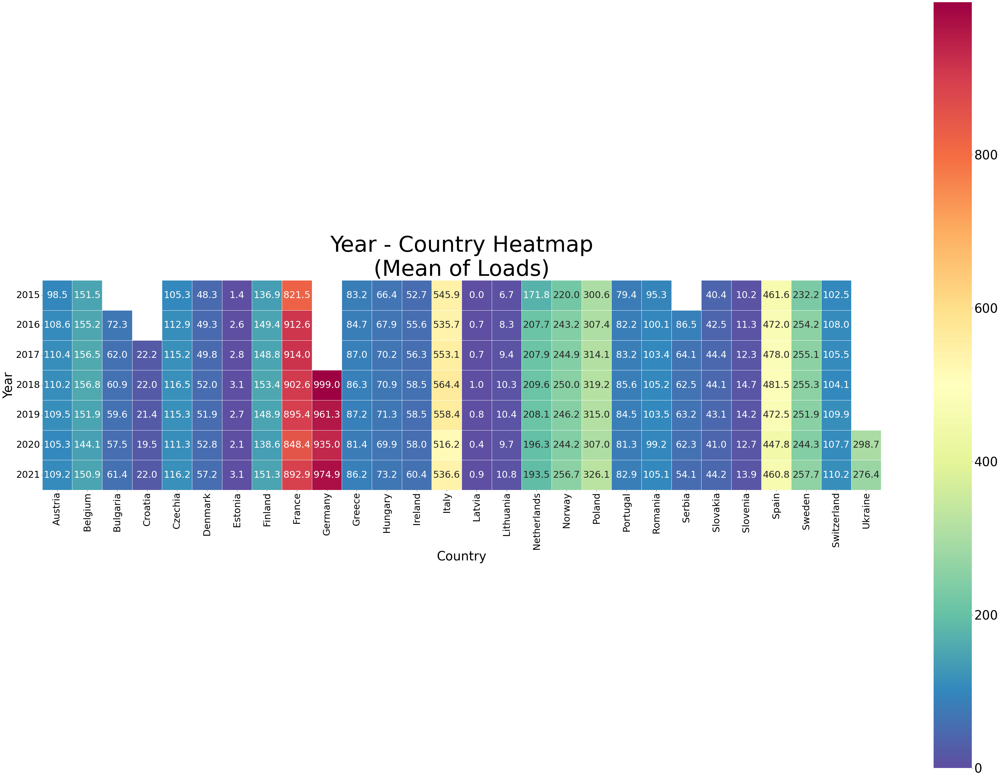

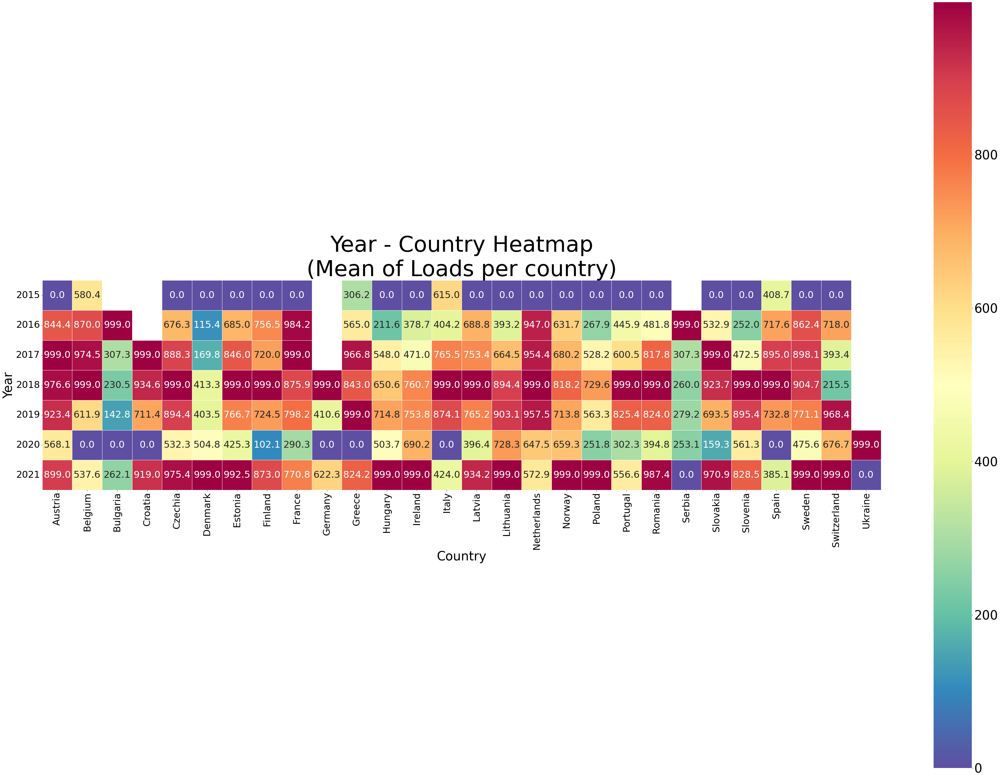

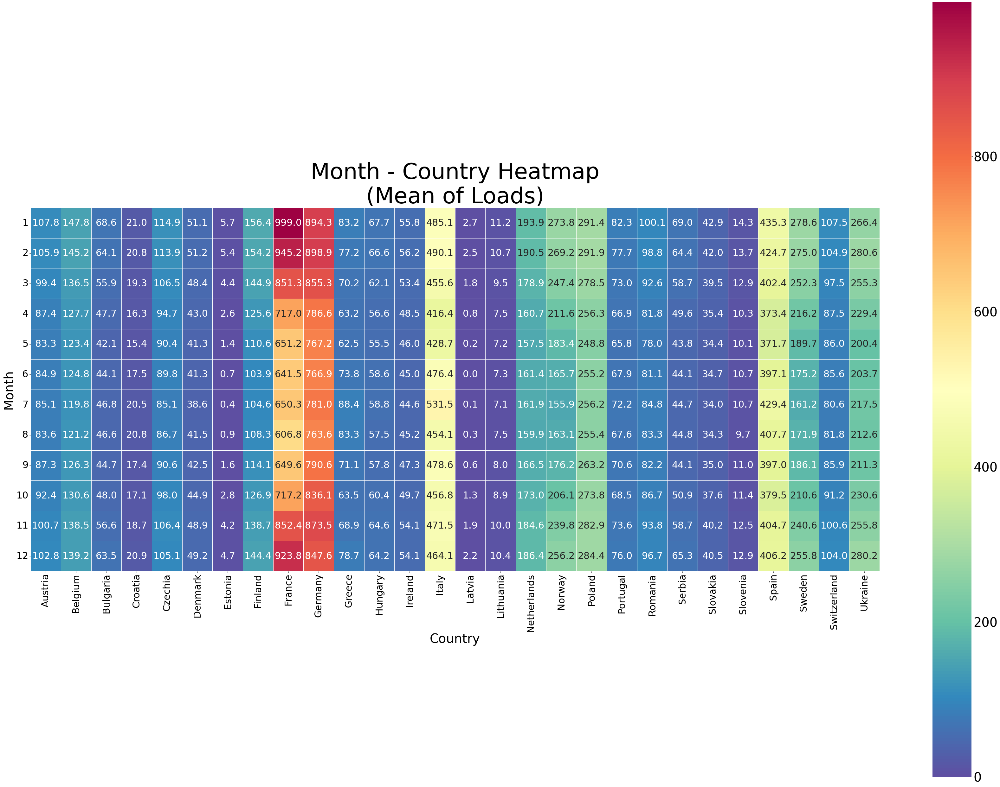

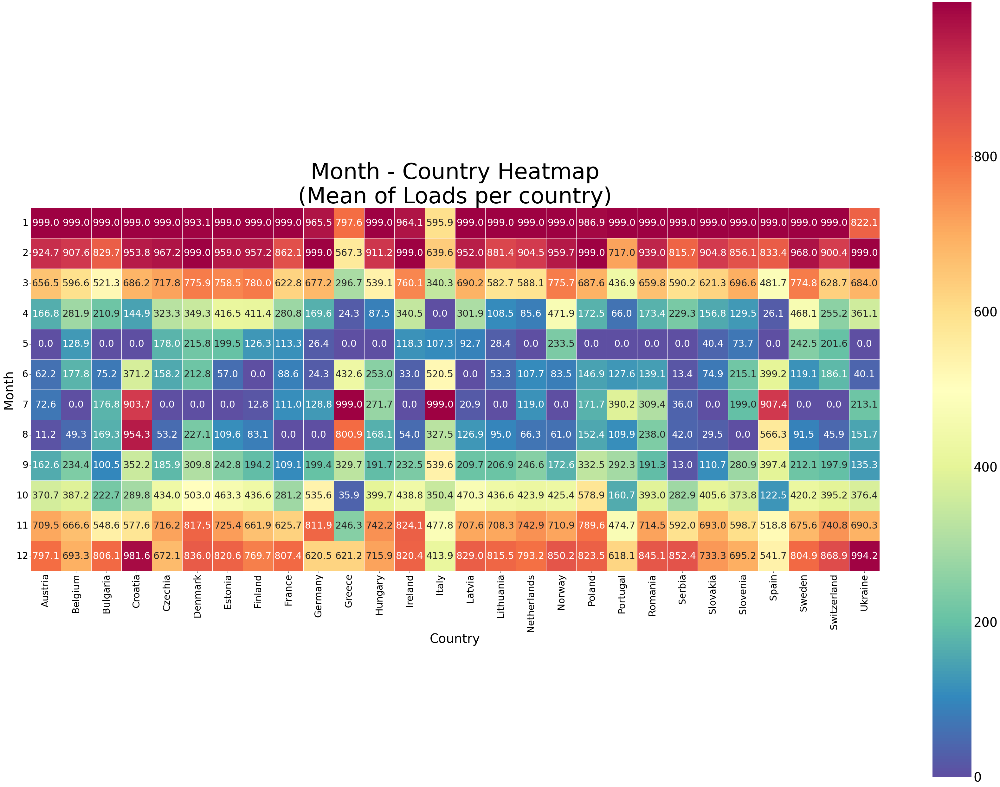

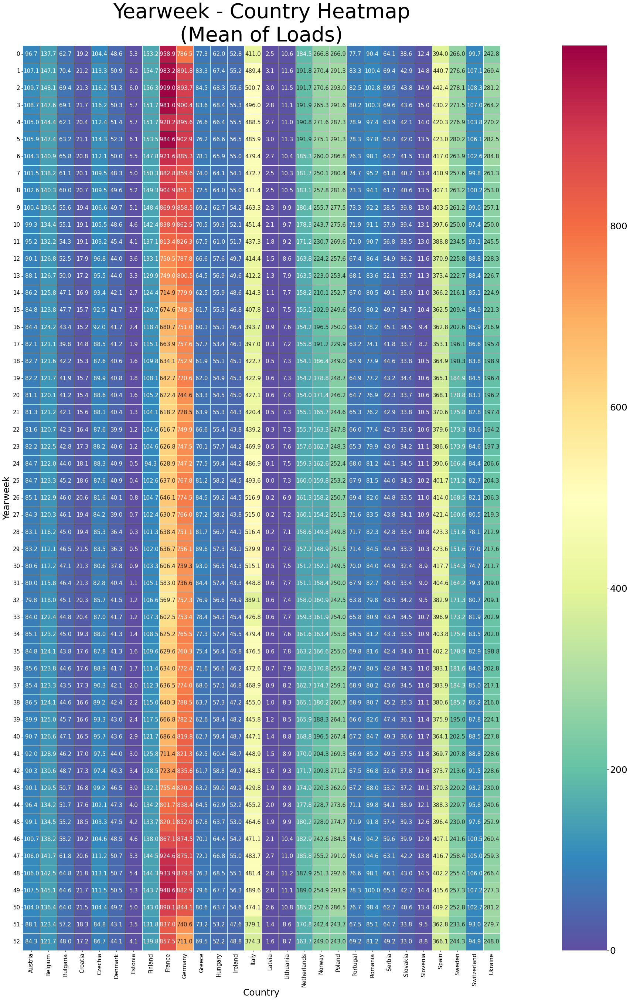

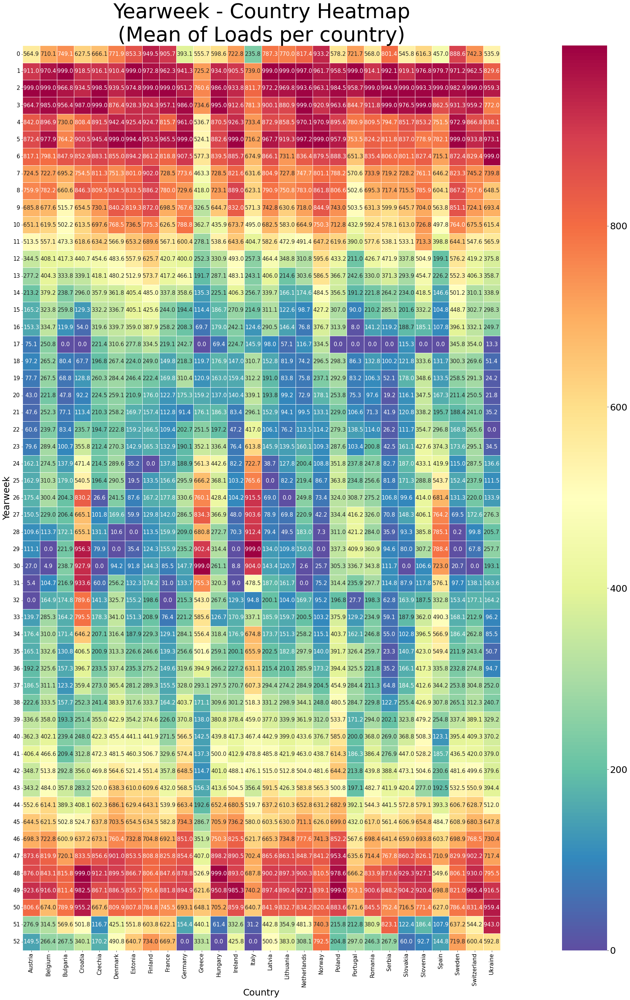

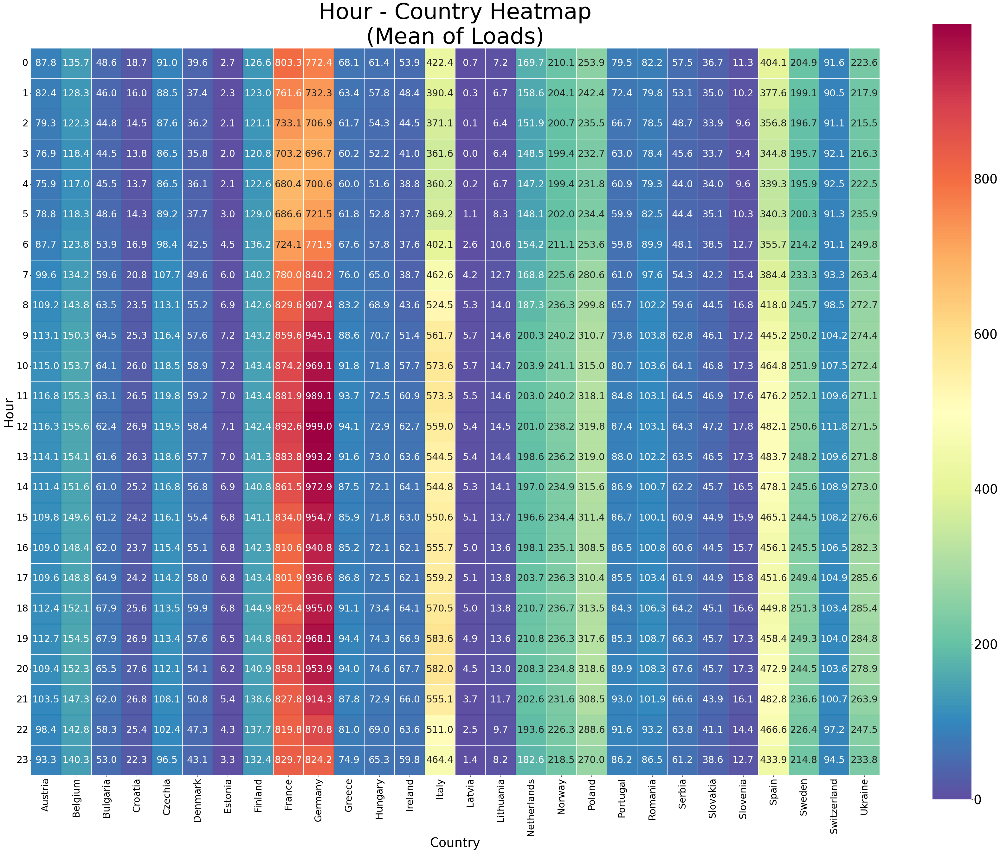

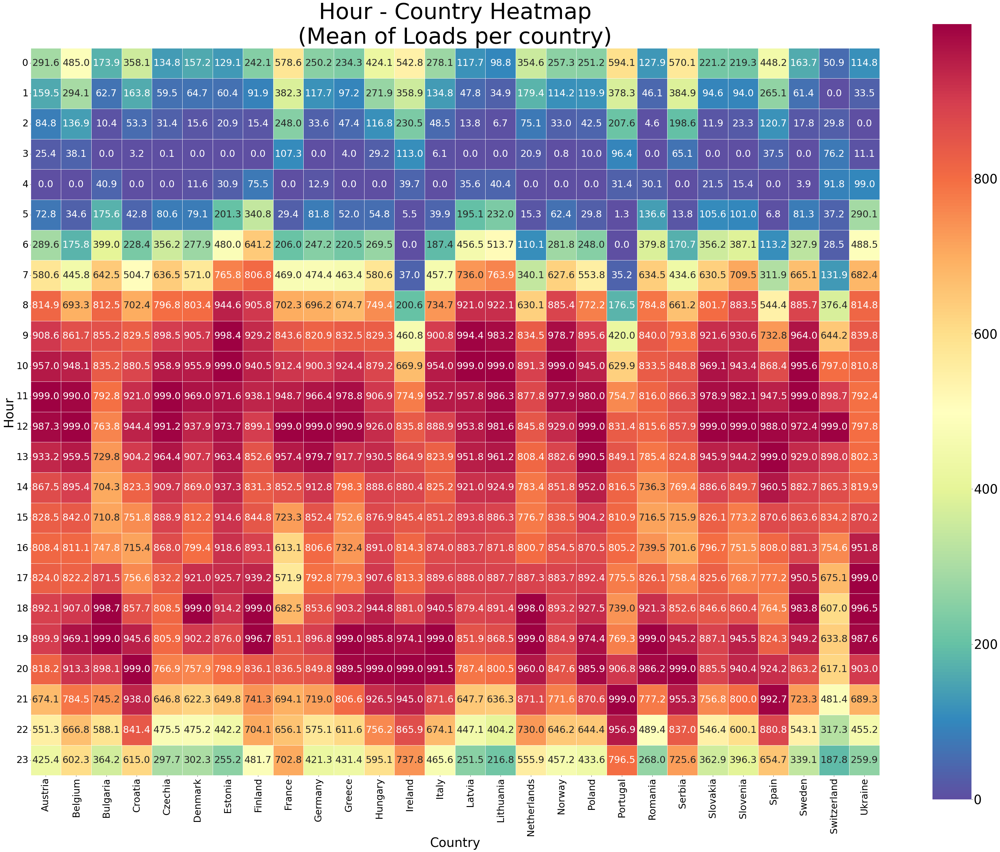

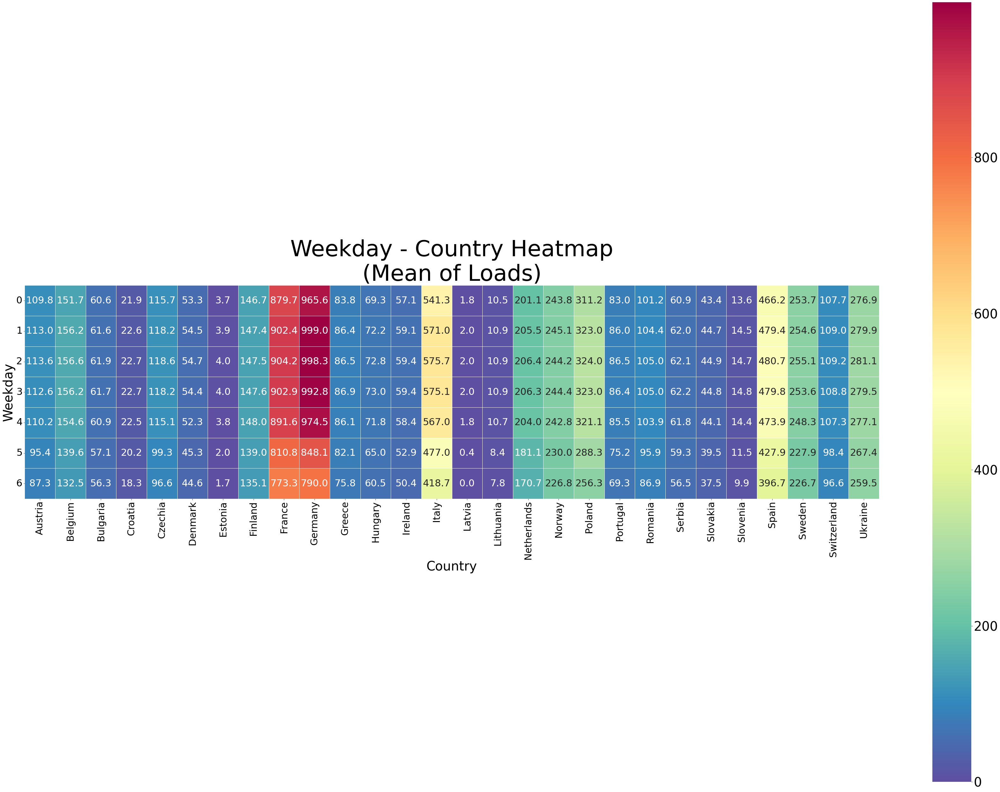

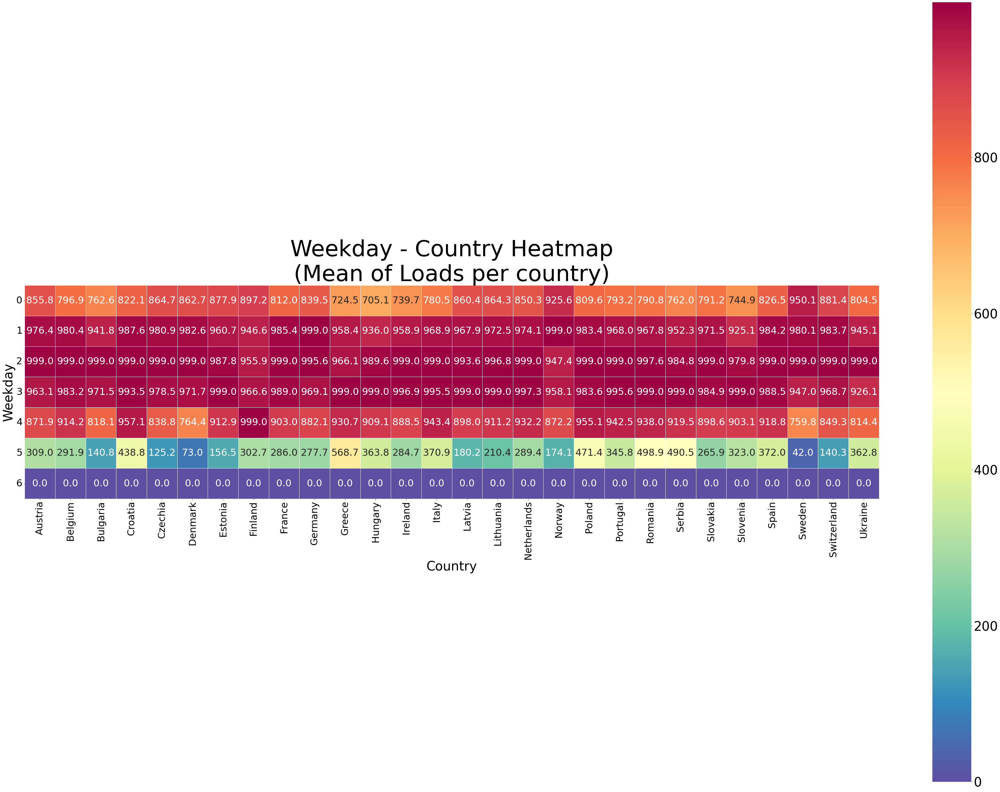

In [21]:
def plot_hmap(dframe, col, annot_size, aggfunc, plot_title):
    """
    This function jus creates the heatmaps of dataframes formed in date_heatmap()
    Parameters: 
        dframe: Pandas.dataframe containing dataframe for heatmap
        col: string which is the name of dframe column and what y-axis of heatmap is going to represent 
        annot_size: size of text inside cells of heatmap
        aggfunc: string containing aggregration function used (title of plot)
    ----------
    Returns: None
    -------
    """
    f, ax = plt.subplots(figsize=(60, 45))
    plt.title(plot_title, fontsize=annot_size+40)

    # Draw the heatmap with the mask and correct aspect ratio
    res = sns.heatmap(dframe, cmap='Spectral_r', square=True, annot=True, 
                      fmt='.1f', annot_kws={"size": annot_size}, ax=ax, linewidths=.9)

    # size of country names
    res.set_xticklabels(res.get_xmajorticklabels(), fontsize = annot_size, rotation = 90)
    res.set_yticklabels(res.get_ymajorticklabels(), fontsize = annot_size, rotation = 0); # ";" to supress print in cell

    #change size of axis labels
    ax.set_xlabel('Country', fontsize = annot_size+10)
    ax.set_ylabel(col.title(), fontsize = annot_size+10)

    # change font size of heatmap colourbar        
    cbar = ax.collections[0].colorbar
    cbar.ax.tick_params(labelsize=annot_size+10)
    
    
def date_heatmap():
    """
    Creates a heatmap where for each country and for some datetime aspects (see values in col paramter)
    displays the sum/mean of energy load for that given col based dataframe,scaled between 0 and 100
    based on min/max values of matrix
    Parameters: None
    ----------
    Returns: None
    -------
    """
    # define our scaling function with custom min/max possible values that x might have 
    scale_func = lambda x: (((x - min) / (max - min))*999)
    
    aggfunc = 'mean' # values: mean/sum/count/max/min
    
    for col in ['year', 'month','yearweek','hour','weekday']:
        # create pivot table with index a given column
        pivot = df.pivot_table('Load', [col], 'country', aggfunc=aggfunc)
        
        """
         Use lambda function above to perform minmax scaling column-wise
         We want out min/max values to be for the whole pivot_table, so sklearn.MinMaxScaler was avoided
         This can be explained by its min()/max() methods which, for a pivot_table, return
         the min/max per column and not of pivot_table (setting of custom methods was in order)
        """
        # find min/max value out of min/max values of all countries (columns)         
        min = pivot.min().min()
        max = pivot.max().max()              
        totalscaled_pivot = pivot.copy()
        totalscaled_pivot[pivot.columns] = scale_func(pivot[pivot.columns]).round(2) #round to two (2) decimals   
        
        countryscaled_pivot = pivot.copy()
        scaler = MinMaxScaler(feature_range=(0, 999)) # scale in specific range
        countryscaled_pivot[pivot.columns] = scaler.fit_transform(pivot[pivot.columns]).round(2)         

        if col=='yearweek': annot_size = 15
        else: annot_size = 30

        # ~~~~~~~~~~~~~~~~~~~~~~~~~~ Plot heatmaps ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~    
        
        plot_title = col.title()+' - Country Heatmap\n({} of Loads)'.format(aggfunc.title())
        plot_hmap(totalscaled_pivot, col, annot_size, aggfunc, plot_title)   # Heatmap normalized by all values
        
        plot_title = col.title()+' - Country Heatmap\n({} of Loads per country)'.format(aggfunc.title())
        plot_hmap(countryscaled_pivot, col, annot_size, aggfunc, plot_title) # Heatmap normalized by country
        
date_heatmap()

In this cell, we create a heatmap where individual countries are displayed on the x-axis, year/yearweek/month/hour/weekday (datetime aspect) are displayed, and finally the annotation inside each cell represents the sum of values for a specific moment of the datetime aspect. Note that values are scaled between zero and one hundred for better readability of our plots
We chose a custom method for minmaxscaling as it this method address normalization based on values of the **entire** dataframe, as opposed to 'sklearn.preprocessing.MinMaxScaler' which normalizes data only per collumn

When creating the pivot table to be used for the heatmap we choose either to register the mean or the sum of values by a single country per datetime aspect. We observe that much difference occurs in the heatmap when datetime aspect is weekday/hour and to a certain extend even month.
In the first category, we can conclude that for:
- __year__: From barplots above, it was clear that data from specific countries were missing. In this heatmap, it becomes more specific for which years do we have lack and from which datasets (countries). When aggregation is sum, we observe (column-wise and in heatmap as a whole) that bigger values are mostly present in the lower part of the heatmap, implying  that energy demand is increasing as we reach present time. It stands to reason, that countries with greater populations and production will 'dominate' the heatmap with the biggest values across all years (France,Germany etc) 
- __month__: there is generally huge energy demand in the early (January-March) and late (Octomber-December) months of each year, which greatly overlaps with the months with the lowest temperatures and therefore greater necessity for energy inside houses and businesses.   
- __weekday/hour__: most of the energy demand is observed at business days/hours, something of course to be expected
- __yearweek__: there are huge spikes in energy demand by a few countries (most notably Greece and Italy) during summer, which can be caused by tourism surge of those coutries at that time of year


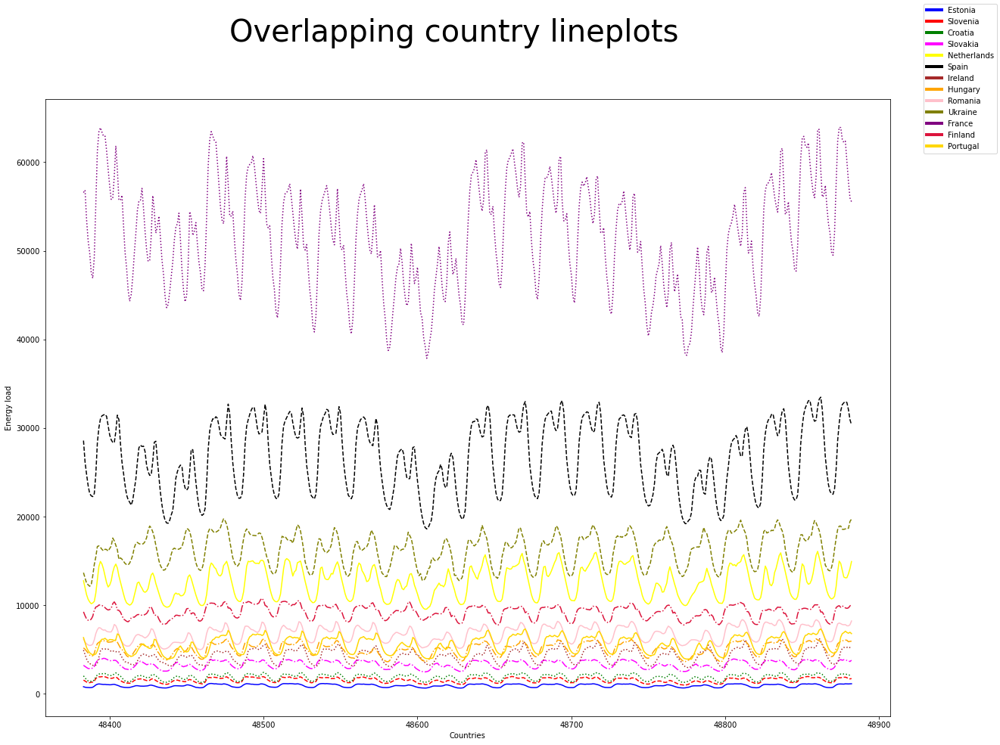

In [15]:
ls = ['-','--',':','-.','-','--',':','-.']
linecycler = cycle(ls) #create an object that can circle around that list

fig, ax = plt.subplots(figsize=(20,15))
fig.suptitle('Overlapping country lineplots', fontsize=40)
fig.subplots_adjust(hspace=0.5) # create space between vertical plots (by axes)

custom_lines = []
country_list = []
colours = ['blue','red','green','magenta','yellow',
           'black','brown','orange','pink','olive',
           'purple','crimson','gold'] # list of colours for plots
colour_iter = iter(colours) #iterator for list of colours

pivot = pivot_df.reset_index()
pivot[pivot['Date'].dt.year == 2019]
dframe_without_na = pivot.dropna()

rand_idx = 500 # 500/24 = 20 days approximately

for country in ['Estonia','Slovenia','Croatia','Slovakia','Netherlands','Spain',
                'Ireland','Hungary','Romania','Ukraine','France','Finland','Portugal']:
    cur_colour = next(colour_iter) 
    cur_linestyle = next(linecycler)
    
    # get a contrinuous 'sample_size' values (sample) of dframe starting from said random idx
    dframe_sample = dframe_without_na.iloc[0 : rand_idx]

    sns.lineplot(data=dframe_sample[country], color=cur_colour, ax=ax, linestyle=cur_linestyle)
    ax.set(xlabel='Countries', ylabel='Energy load')

    # add lines and labels for legend based on those used for lineplot above
    custom_lines.append(Line2D([0], [0], color=cur_colour, lw=4))
    country_list.append(country)

fig.legend(custom_lines, country_list);
    

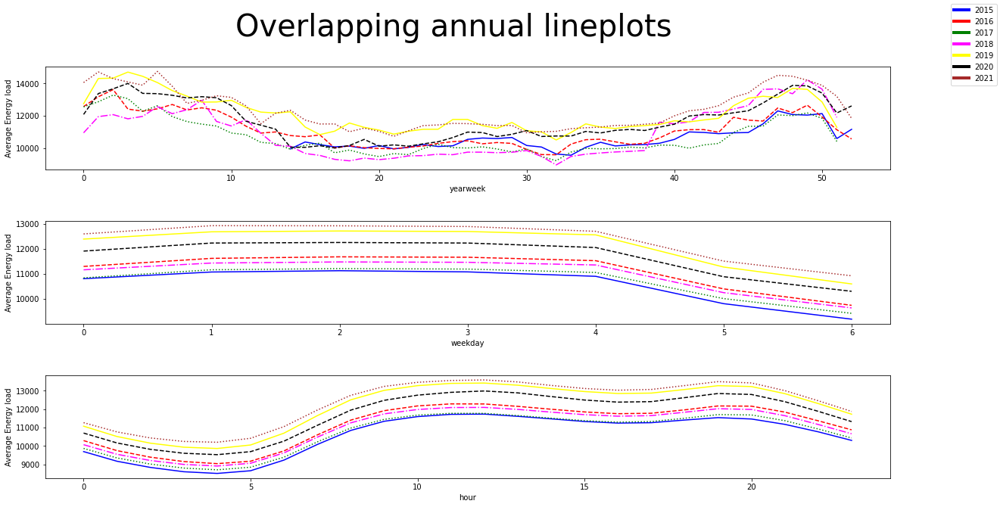

In [16]:
def annual_lineplots():
    """
    Above we plot lines where each line is a different year to demonstrate how values shift 
    on average every year based on yearweek/weekday/hour.
    In the x-axis, we display the datetime (52/6/24 values for yearkweeks/weekdays/hours per year respectively). 
    In the y-axis, it is the average value of a given x-axis for that year
    Parameters: None
    ----------
    Returns: None
    -------
    """
    # make a list out of possible linestyle we want our line plots to have
    ls = ['-','--',':','-.','-','--',':','-.']
    linecycler = cycle(ls) #create an object that can circle around that list

    fig, ax = plt.subplots(3, 1, figsize=(20,10))
    fig.suptitle('Overlapping annual lineplots', fontsize=40)
    fig.subplots_adjust(hspace=0.5) # create space between vertical plots (by axes)

    custom_lines = []
    years = []
    colours = ['blue','red','green','magenta','yellow','black','brown','orange','pink'] # list of colours for plots
    colour_iter = iter(colours) #iterator for list of colours
    
    
    #for each unique year in our dataset (2015-2022)
    for year in df['year'].unique():
    #     cur_colour = "#" + ''.join(random.choices("ABCDEF" + string.digits, k=6))
        #get a new colour and linestyle to plot
        cur_colour = next(colour_iter) 
        cur_linestyle = next(linecycler)
        
        # for each datetime_parameter we want our x-axis to be
        for axes,datetime_cov in enumerate(['yearweek', 'weekday', 'hour']):
            # find the mean value of energy load for each datetime_parameter for a given year based 
            temp = df[df['year']==year].groupby(datetime_cov)['Load'].mean()
            sns.lineplot(data=temp, color=cur_colour, ax=ax[axes], linestyle=cur_linestyle)
            ax[axes].set(xlabel=datetime_cov, ylabel='Average Energy load')
        
        # add lines and labels for legend based on those used for lineplot above
        custom_lines.append(Line2D([0], [0], color=cur_colour, lw=4))
        years.append(year)
    
    fig.legend(custom_lines, years)

annual_lineplots()    

Above we plot lines where each line is a different year to demonstrate how values shift on average every year based on yearweek/weekday/hour.In the x-axis, we display the datetime (52/6/24 values for yearkweeks/weekdays/hours per year respectively). In the y-axis, it is the average value of a given x-axis for that year 

While it is not that evident in the yearweek plot, in the weekday/hour plots there is a clear rise of the entire lines with each year, meaning a steady increase in average energy load per year. Important exception to this rule is the year 2020 which is lower than 2019-2021. A reasonable explanation to be the behaviour and demands for energy during the covid pandemic at that time. Finally in the yearweek plot, we can see the lineplot for 2022 to take a linear approach in contrast to all the others which can be attributed to the imputation (and most speicifically lack) of data during that year

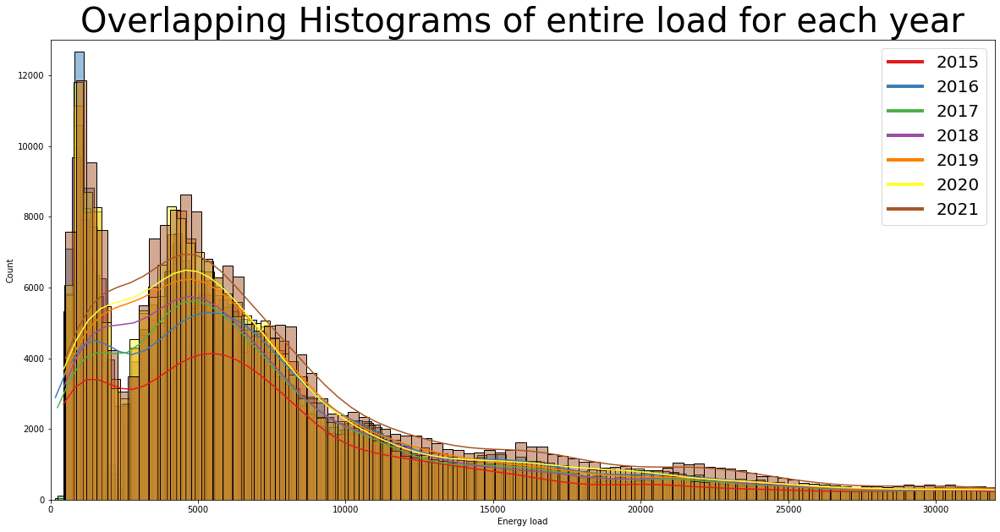

In [17]:
def year_histograms():
    """
    In this function, we create overlapping histograms where each histogram is 
    the entirety of our dataset (all countries) for a different year 
    Parameters: None
    ----------
    Returns: None
    -------
    """
    # see code from previous cell for relative explanation of code
    custom_lines = []
    years = []
    pallete = []
    # ~~~~~~~~~~~~~~~~~~~~~ Colour based on cmap ~~~~~~~~~~~~~~~~~~~~~~~~~~
    cmap = mpl.cm.get_cmap('Set1')    
    for val in np.arange(0, 1, 0.12).tolist(): pallete.append(cmap(val))
    pallete_cycler = cycle(pallete)
    # ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
    
    fig, ax = plt.subplots(figsize=(20,10))
    ax.set(xlabel='Energy load', ylabel='Count')
    plt.title('Overlapping Histograms of entire load for each year', fontsize=40)
    plt.xlim(0, 32000);
    plt.ylim(0, 13000);

    for year in df['year'].unique():
        temp = df[df['year']==year]
    #     cur_colour = "#" + ''.join(random.choices("ABCDEF" + string.digits, k=6))
        cur_colour = next(pallete_cycler)
        sns.histplot(temp['Load'], ax=ax, kde=True, color=cur_colour)
        custom_lines.append(Line2D([0], [0], color=cur_colour, lw=4))
        years.append(year)
    
    ax.legend(custom_lines, years,fontsize=20);
    
year_histograms()

The plot above demonstrates overlapping histograms where each histogram is the entirety of our dataset (all countries)
for a different year. 

From this plot, a clear increase in energy demand is evident per year, with an obvious exception our current year (2022)

In [18]:
# When we run this cell the report process will be kicked off and 
# analyse all of your data within the dataframe

# https://towardsdatascience.com/pandas-profiling-easy-exploratory-data-analysis-in-python-65d6d0e23650
from pandas_profiling import ProfileReport

def create_profile_report(): return ProfileReport(df)

pivot_report = create_profile_report()
pivot_report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]